# Final Code and Notebook

We start with downloading the raw load data, if not already available, and checking which areas are extra/missing in each year.

In [2]:
import os
import requests
import tarfile
import zipfile
import glob
import pandas as pd

# -------------------------------
# 1. Check availability of raw data folder
# -------------------------------

DATA_DIR = "data/raw"
TARGET_FOLDER = os.path.join(DATA_DIR, "hrl_load_metered_2016-2025")
OSF_ZIP_URL = "https://files.osf.io/v1/resources/Py3u6/providers/osfstorage/?zip="

os.makedirs(DATA_DIR, exist_ok=True)

if not os.path.isdir(TARGET_FOLDER):
    print("Raw folder missing. Downloading from OSF...")

    zip_path = os.path.join(DATA_DIR, "hrl_load_tmp.zip")

    # ---- Download the .zip archive ----
    print("Downloading ZIP archive...")
    r = requests.get(OSF_ZIP_URL)
    r.raise_for_status()
    with open(zip_path, "wb") as f:
        f.write(r.content)
    print("Download complete.")

    # ---- Extract ZIP (contains a TAR file) ----
    print("Extracting ZIP...")
    with zipfile.ZipFile(zip_path, "r") as z:
        z.extractall(DATA_DIR)

    # Find the TAR archive inside
    extracted_files = [f for f in os.listdir(DATA_DIR) if f.endswith((".tar", ".tar.gz", ".tgz"))]
    if not extracted_files:
        raise RuntimeError("No TAR file found after unzipping OSF archive.")
    tar_file = os.path.join(DATA_DIR, extracted_files[0])

    # ---- Extract TAR archive ----
    print(f"Extracting TAR archive {tar_file}...")
    with tarfile.open(tar_file, "r:*") as tar:
        tar.extractall(DATA_DIR)

    # Remove temporary files
    os.remove(zip_path)
    os.remove(tar_file)

    if os.path.isdir(TARGET_FOLDER):
        print("Successfully extracted hrl_load_metered_2016-2025 into data/raw/")
    else:
        raise RuntimeError("Extraction completed but target folder was not found.")
else:
    print("Raw folder already exists; skipping download.")

# -------------------------------
# 2. Check missing/extra load areas
# -------------------------------

required_load_areas = [
    "AECO", "AEPAPT", "AEPIMP", "AEPKPT", "AEPOPT",
    "AP", "BC", "CE", "DAY", "DEOK", "DOM", "DPLCO",
    "DUQ", "EASTON", "EKPC", "JC", "ME", "OE", "OVEC",
    "PAPWR", "PE", "PEPCO", "PLCO", "PN", "PS",
    "RECO", "SMECO", "UGI", "VMEU"
]
required_set = set(required_load_areas)

path = TARGET_FOLDER
files = sorted(glob.glob(os.path.join(path, "hrl_load_metered_*.csv")))

for f in files:
    year = os.path.basename(f).split("_")[-1].split(".")[0]
    df = pd.read_csv(f, usecols=["load_area"])

    present = set(df["load_area"].dropna().unique())

    missing = sorted(required_set - present)
    extra   = sorted(present - required_set)

    print(f"\n================ YEAR {year} ================")
    print(f"Has all 29 required load areas?  {'YES' if not missing else 'NO'}")
    print(f"Number of required load areas present: {29 - len(missing)}/29")

    if missing:
        print("  Missing load areas:")
        print("   ", missing)

    if extra:
        print("  Extra (non-required) load areas present:")
        print("   ", extra)

Raw folder already exists; skipping download.

================ YEAR 2016 ================
Has all 29 required load areas?  NO
Number of required load areas present: 26/29
  Missing load areas:
    ['AECO', 'OVEC', 'VMEU']
  Extra (non-required) load areas present:
    ['AE', 'RTO']

================ YEAR 2017 ================
Has all 29 required load areas?  NO
Number of required load areas present: 28/29
  Missing load areas:
    ['OVEC']
  Extra (non-required) load areas present:
    ['RTO']

================ YEAR 2018 ================
Has all 29 required load areas?  YES
Number of required load areas present: 29/29
  Extra (non-required) load areas present:
    ['RTO']

================ YEAR 2019 ================
Has all 29 required load areas?  YES
Number of required load areas present: 29/29
  Extra (non-required) load areas present:
    ['RTO']

================ YEAR 2020 ================
Has all 29 required load areas?  YES
Number of required load areas present: 29/29
  Extra (

## Handling EPT and UTC times

In [4]:
'''
Processing EPT-UTC times and adding EPT features
'''
import os
import glob
import pandas as pd

input_dir = "data/raw/hrl_load_metered_2016-2025"
output_dir = "data/processed"
os.makedirs(output_dir, exist_ok=True)

def process_load_file(csv_path: str) -> pd.DataFrame:
    print(f"\nProcessing {csv_path} ...")
    
    # Read raw data
    df = pd.read_csv(csv_path)

    # Make tz-aware UTC timestamps from the UTC beginning column
    ts_utc = pd.to_datetime(df["datetime_beginning_utc"], utc=True)

    # Add UTC timestamp column, set it as index, sort
    df = (
        df
        .assign(ts_utc=ts_utc)
        .set_index("ts_utc")
        .sort_index()
    )

    # Convert index to EPT (America/New_York)
    ts_ept = df.index.tz_convert("America/New_York")

    # EPT-based calendar features
    df["hour_ept"]  = ts_ept.hour
    df["dow_ept"]   = ts_ept.dayofweek
    df["date_ept"]  = ts_ept.date
    df["month_ept"] = ts_ept.month

    # ISO week/year; assign by position to avoid index-alignment issues
    iso = ts_ept.isocalendar()
    df["week_ept"]     = iso.week.to_numpy()
    df["iso_year_ept"] = iso.year.to_numpy()

    # --------------------------------------------------------------
    # Timezone offset checks
    # --------------------------------------------------------------
    # Rebuild an EPT series from original UTC timestamps
    ts_ept_series = ts_utc.dt.tz_convert("America/New_York")
    # Get UTC offsets via .apply (works across pandas versions)
    offsets = ts_ept_series.apply(lambda x: x.utcoffset())

    # Overall unique offsets in this file
    print("  Unique UTC offsets overall:", list(pd.Series(offsets).drop_duplicates()))

    # Check if any load_area has more than one offset
    if "load_area" in df.columns:
        df_offsets = df.copy()
        df_offsets["offset"] = offsets.to_numpy()
        offsets_by_area = df_offsets.groupby("load_area")["offset"].nunique()

        multi_offset_areas = offsets_by_area[offsets_by_area > 1]
        if not multi_offset_areas.empty:
            print("  WARNING: load areas with >1 unique UTC offset:")
            print(multi_offset_areas.head())
        else:
            print("  All load areas have a single UTC offset (only DST/standard).")

    return df

# Loop over all yearly CSVs and save processed versions
csv_files = sorted(glob.glob(os.path.join(input_dir, "hrl_load_metered_*.csv")))

for csv_path in csv_files:
    df_processed = process_load_file(csv_path)

    base = os.path.basename(csv_path)
    out_path = os.path.join(output_dir, base)
    df_processed.to_csv(out_path)
    print(f"  Saved processed file to: {out_path}")



Processing data/raw/hrl_load_metered_2016-2025/hrl_load_metered_2016.csv ...
  Unique UTC offsets overall: [Timedelta('-1 days +19:00:00'), Timedelta('-1 days +20:00:00')]
load_area
AE        2
AEPAPT    2
AEPIMP    2
AEPKPT    2
AEPOPT    2
Name: offset, dtype: int64
  Saved processed file to: data/processed/hrl_load_metered_2016.csv

Processing data/raw/hrl_load_metered_2016-2025/hrl_load_metered_2017.csv ...
  Unique UTC offsets overall: [Timedelta('-1 days +19:00:00'), Timedelta('-1 days +20:00:00')]
load_area
AECO      2
AEPAPT    2
AEPIMP    2
AEPKPT    2
AEPOPT    2
Name: offset, dtype: int64
  Saved processed file to: data/processed/hrl_load_metered_2017.csv

Processing data/raw/hrl_load_metered_2016-2025/hrl_load_metered_2018.csv ...
  Unique UTC offsets overall: [Timedelta('-1 days +19:00:00'), Timedelta('-1 days +20:00:00')]
load_area
AECO      2
AEPAPT    2
AEPIMP    2
AEPKPT    2
AEPOPT    2
Name: offset, dtype: int64
  Saved processed file to: data/processed/hrl_load_met

## Removing extra load areas and reporting missing areas

In [6]:
'''
Removing extra load areas and reporting which areas are missing in some years
'''
import os
import glob
import pandas as pd

# Folder with your already-processed CSVs
processed_dir = "data/processed"

# Official list of required load areas
required_load_areas = [
    "AECO", "AEPAPT", "AEPIMP", "AEPKPT", "AEPOPT",
    "AP", "BC", "CE", "DAY", "DEOK", "DOM", "DPLCO",
    "DUQ", "EASTON", "EKPC", "JC", "ME", "OE", "OVEC",
    "PAPWR", "PE", "PEPCO", "PLCO", "PN", "PS",
    "RECO", "SMECO", "UGI", "VMEU"
]

# Find all processed CSVs
csv_files = sorted(glob.glob(os.path.join(processed_dir, "hrl_load_metered_*.csv")))

for csv_path in csv_files:
    print(f"\nProcessing (filtering) {csv_path} ...")
    
    # Read processed file; keep the existing index (ts_utc)
    df = pd.read_csv(csv_path, index_col=0)
    
    before_rows = len(df)
    before_areas = set(df["load_area"].unique())
    
    # Keep only required load areas
    df_filtered = df[df["load_area"].isin(required_load_areas)].copy()
    
    after_rows = len(df_filtered)
    after_areas = set(df_filtered["load_area"].unique())
    
    # Info messages
    removed_areas = sorted(before_areas - after_areas)
    missing_required = sorted(set(required_load_areas) - after_areas)
    
    print(f"  Rows before: {before_rows:,} | after: {after_rows:,}")
    print(f"  Load areas kept ({len(after_areas)}): {sorted(after_areas)}")
    
    if removed_areas:
        print(f"  Removed extra load areas: {removed_areas}")
    else:
        print("  No extra load areas removed.")
    
    if missing_required:
        print(f"  Required load areas NOT present in this year (informational only): {missing_required}")
    else:
        print("  All required load areas present in this year.")
    
    # Overwrite the existing CSV with filtered data
    df_filtered.to_csv(csv_path)
    print(f"  Overwrote file with filtered data: {csv_path}")



Processing (filtering) data/processed/hrl_load_metered_2016.csv ...
  Rows before: 245,952 | after: 228,384
  Load areas kept (26): ['AEPAPT', 'AEPIMP', 'AEPKPT', 'AEPOPT', 'AP', 'BC', 'CE', 'DAY', 'DEOK', 'DOM', 'DPLCO', 'DUQ', 'EASTON', 'EKPC', 'JC', 'ME', 'OE', 'PAPWR', 'PE', 'PEPCO', 'PLCO', 'PN', 'PS', 'RECO', 'SMECO', 'UGI']
  Removed extra load areas: ['AE', 'RTO']
  Required load areas NOT present in this year (informational only): ['AECO', 'OVEC', 'VMEU']
  Overwrote file with filtered data: data/processed/hrl_load_metered_2016.csv

Processing (filtering) data/processed/hrl_load_metered_2017.csv ...
  Rows before: 250,417 | after: 241,657
  Load areas kept (28): ['AECO', 'AEPAPT', 'AEPIMP', 'AEPKPT', 'AEPOPT', 'AP', 'BC', 'CE', 'DAY', 'DEOK', 'DOM', 'DPLCO', 'DUQ', 'EASTON', 'EKPC', 'JC', 'ME', 'OE', 'PAPWR', 'PE', 'PEPCO', 'PLCO', 'PN', 'PS', 'RECO', 'SMECO', 'UGI', 'VMEU']
  Removed extra load areas: ['RTO']
  Required load areas NOT present in this year (informational only

## Plots to observe some patterns

In [8]:
import os
import glob
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# =========================================================
# 0. LOAD & PREP MASTER DATAFRAME
# =========================================================

processed_dir = "data/processed"
csv_files = sorted(glob.glob(os.path.join(processed_dir, "hrl_load_metered_*.csv")))

dfs = []
for path in csv_files:
    df_year = pd.read_csv(path, index_col=0, parse_dates=True)
    dfs.append(df_year)

df = pd.concat(dfs).sort_index()

# Ensure date_ept is datetime (it may have been saved as string)
df["date_ept"] = pd.to_datetime(df["date_ept"])

# Year / day-of-year / season in EPT
df["year_ept"] = df["date_ept"].dt.year
df["doy_ept"]  = df["date_ept"].dt.dayofyear   # 1–365/366

# Season based on meteorological definition
def season_from_month(m):
    if m in (12, 1, 2):
        return "winter"
    elif m in (3, 4, 5):
        return "spring"
    elif m in (6, 7, 8):
        return "summer"
    else:
        return "autumn"

df["season"] = df["date_ept"].dt.month.map(season_from_month)

# For meteorological "season year" (winter Dec→Feb counted as the year of Jan/Feb):
df["season_year"] = df["year_ept"].where(df["date_ept"].dt.month != 12,
                                         df["year_ept"] + 1)

regions = sorted(df["load_area"].unique())
years   = sorted(df["year_ept"].unique())
print("Regions:", regions)
print("Years:", years)


Regions: ['AECO', 'AEPAPT', 'AEPIMP', 'AEPKPT', 'AEPOPT', 'AP', 'BC', 'CE', 'DAY', 'DEOK', 'DOM', 'DPLCO', 'DUQ', 'EASTON', 'EKPC', 'JC', 'ME', 'OE', 'OVEC', 'PAPWR', 'PE', 'PEPCO', 'PLCO', 'PN', 'PS', 'RECO', 'SMECO', 'UGI', 'VMEU']
Years: [2016, 2017, 2018, 2019, 2020, 2021, 2022, 2023, 2024, 2025]


### Effect of Seasons

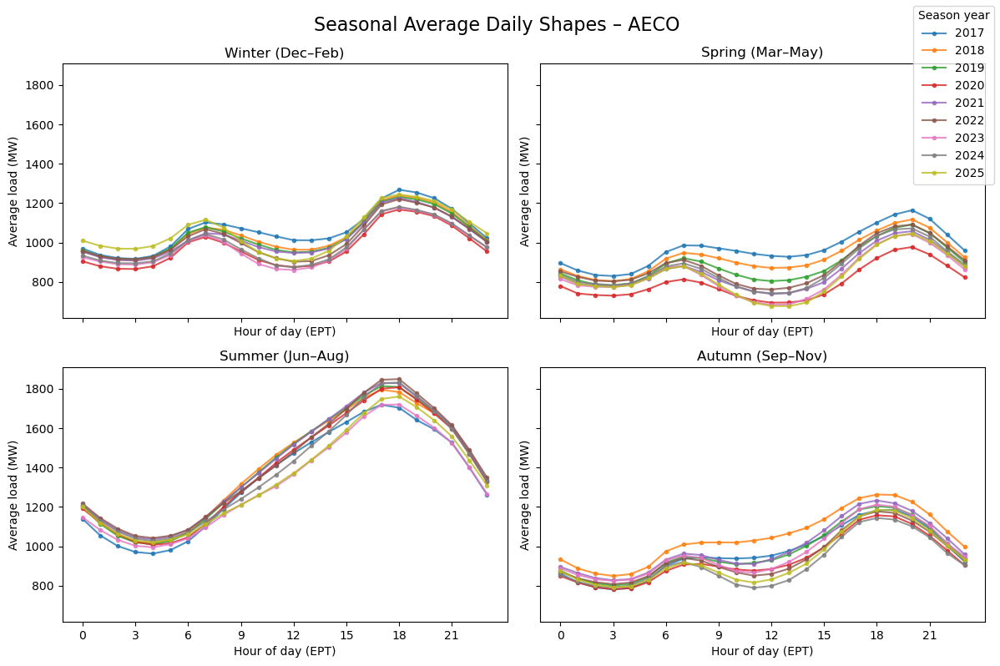

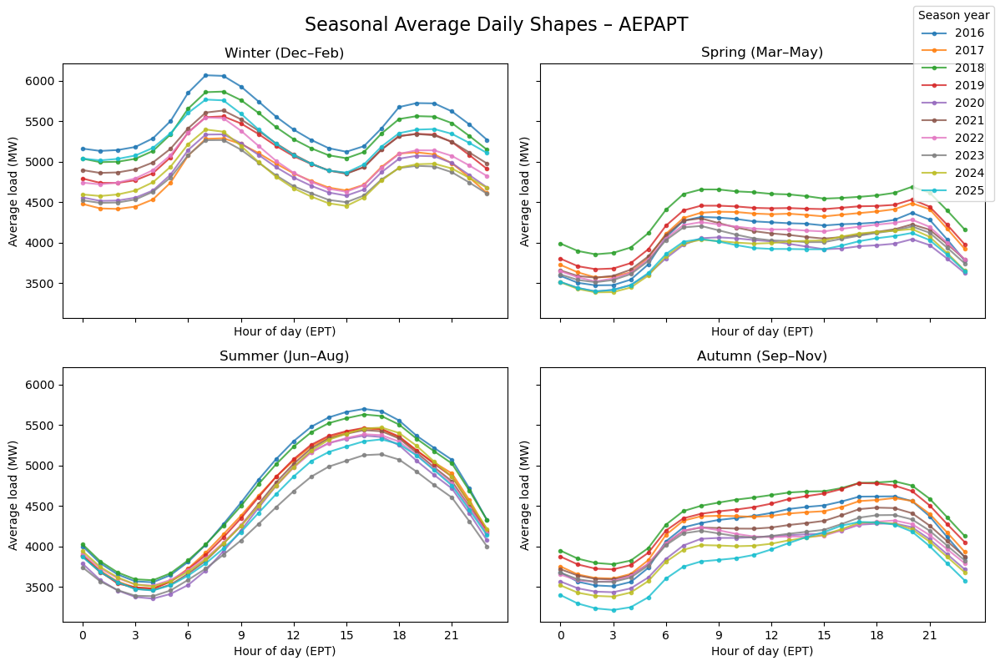

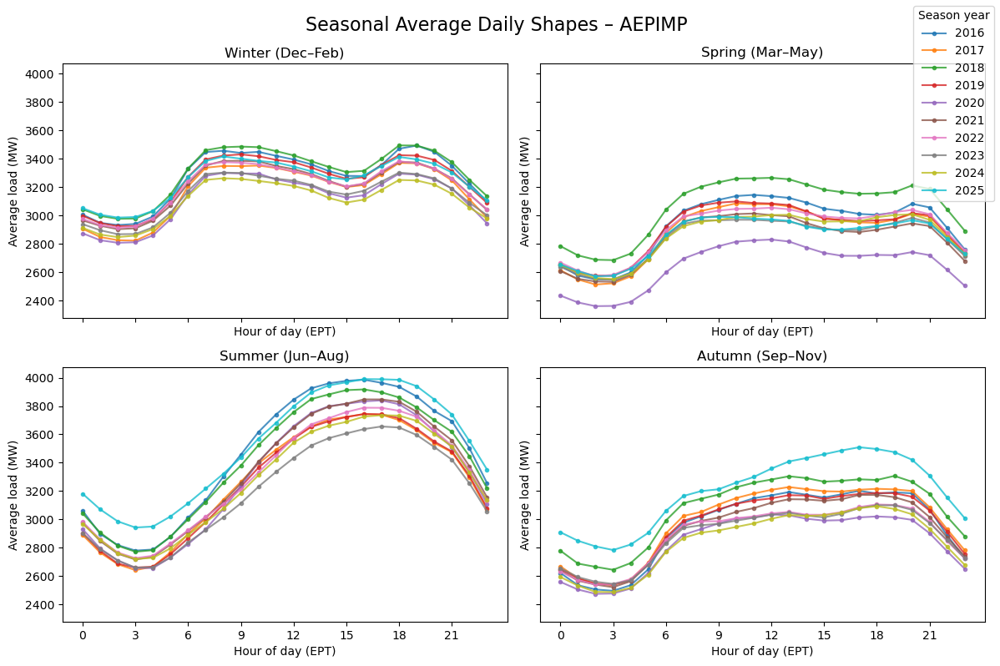

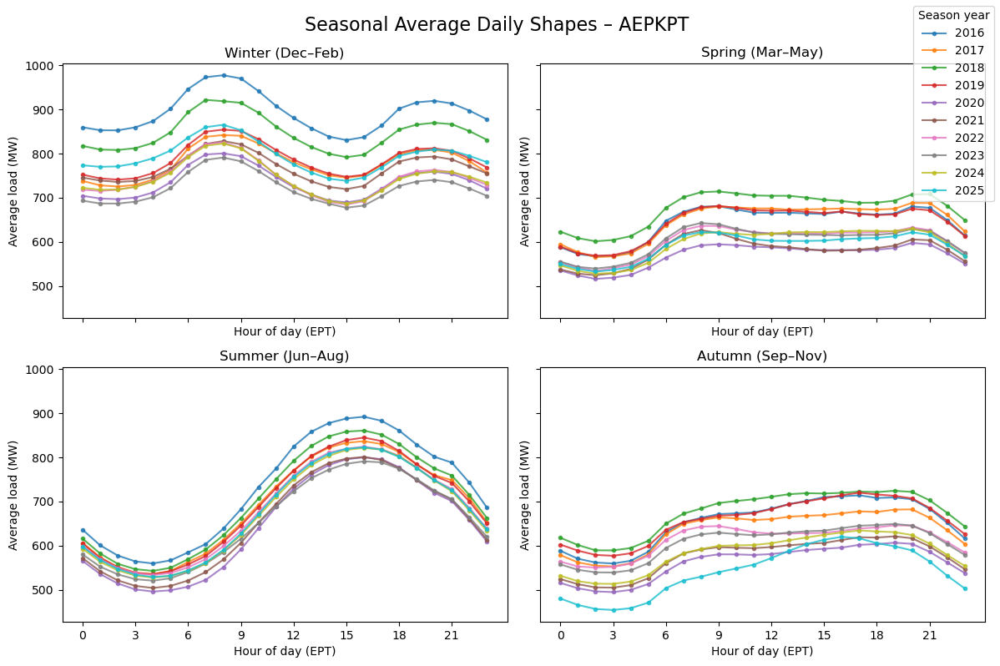

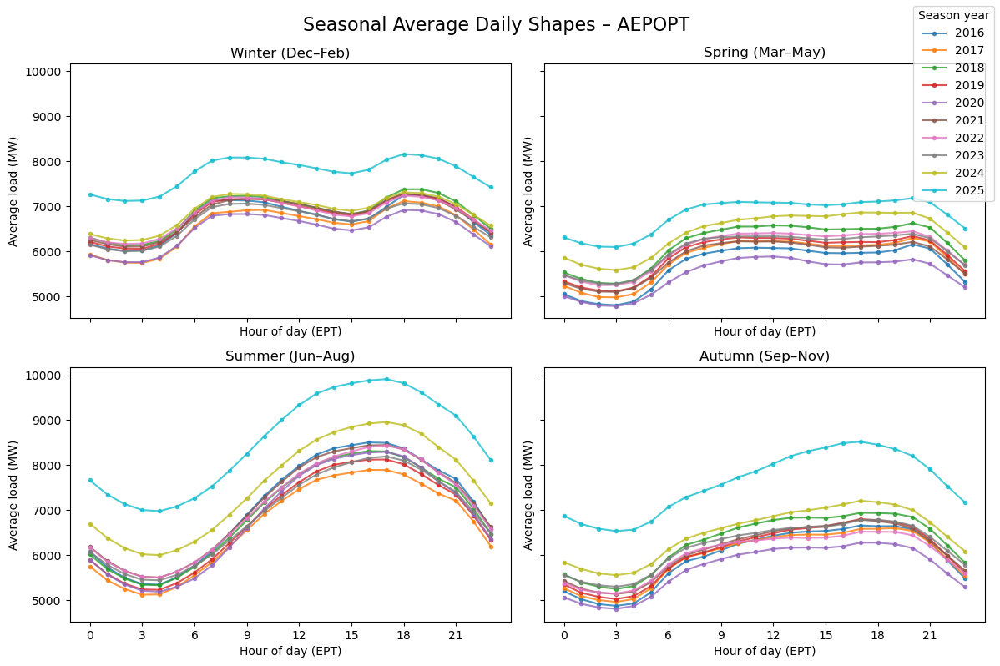

...

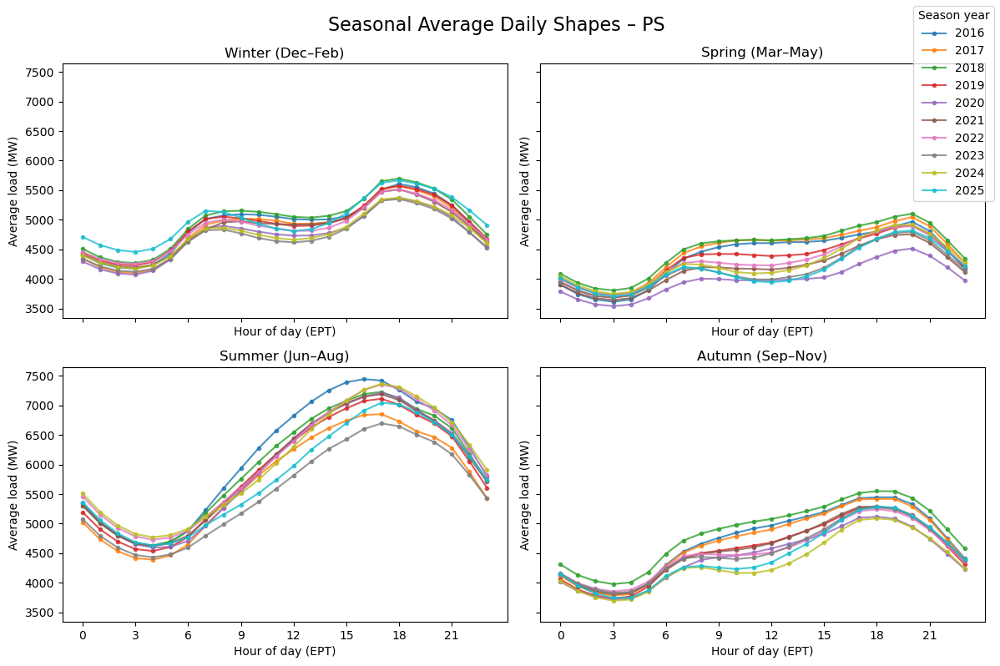

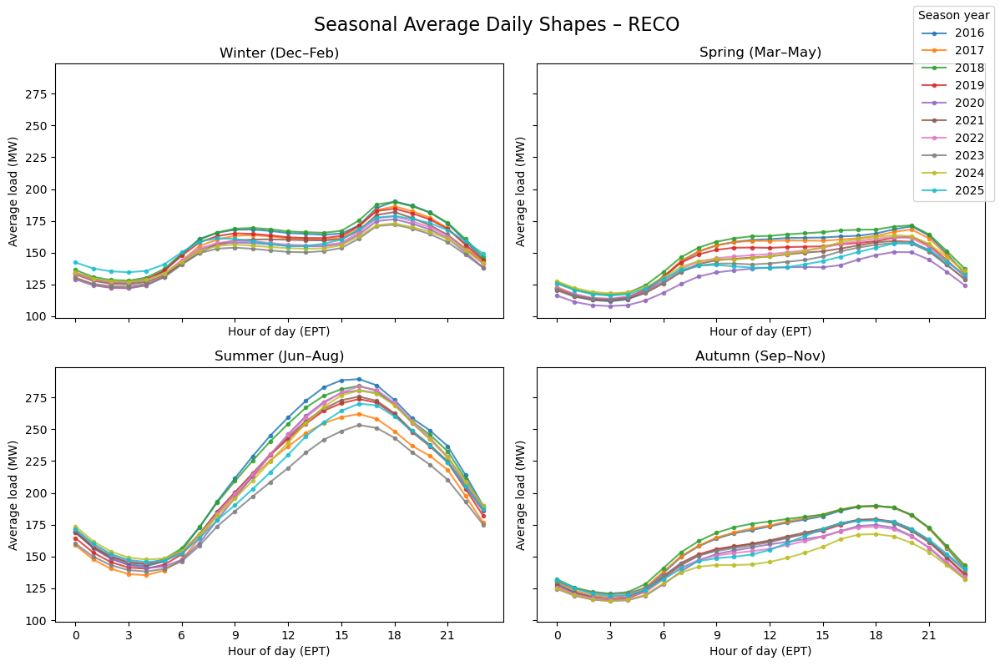

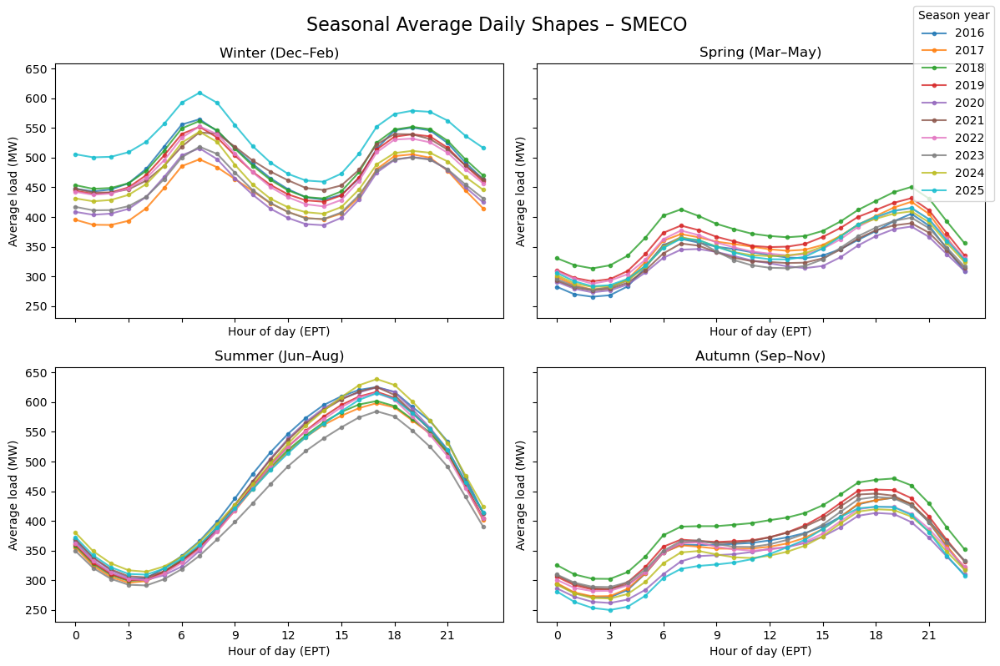

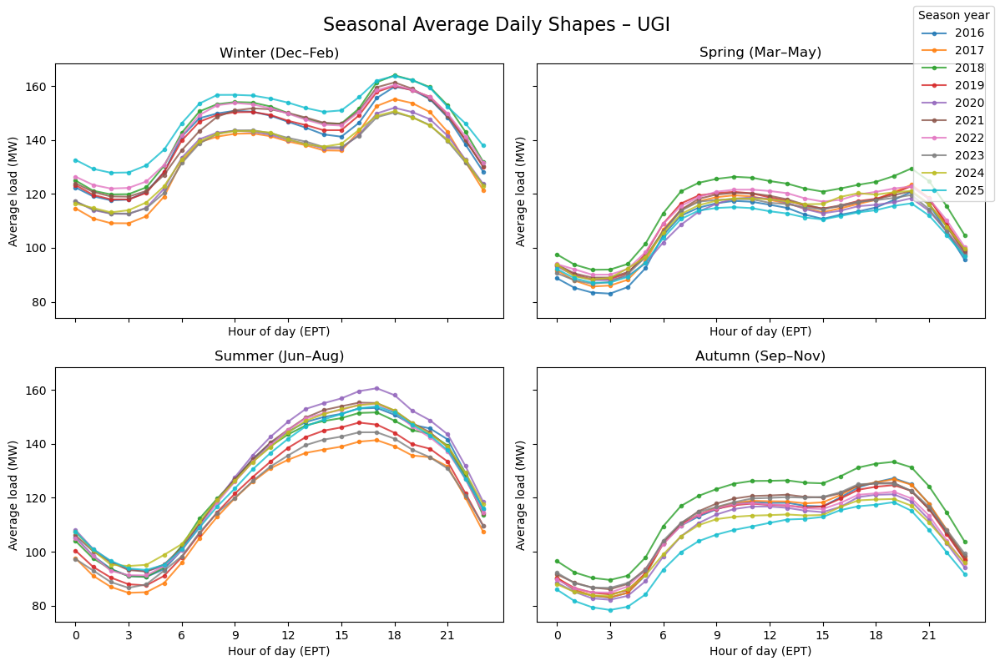

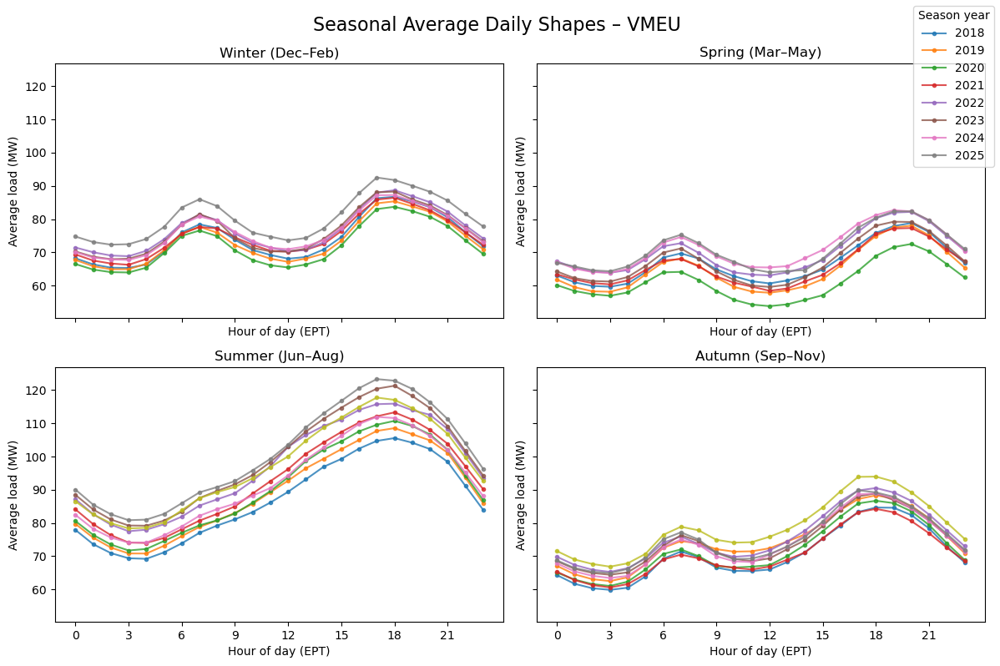

In [10]:
# =========================================================
# 1. SEASONAL AVERAGE DAILY SHAPES BY REGION & YEAR
# =========================================================

seasons = ["winter", "spring", "summer", "autumn"]
season_titles = {
    "winter": "Winter (Dec–Feb)",
    "spring": "Spring (Mar–May)",
    "summer": "Summer (Jun–Aug)",
    "autumn": "Autumn (Sep–Nov)"
}
save_dir = "EDA_plots/season_plots"

for region in regions:
    df_r = df[df["load_area"] == region]
    
    fig, axes = plt.subplots(2, 2, figsize=(12, 8), sharex=True, sharey=True)
    axes = axes.ravel()
    
    for i, season in enumerate(seasons):
        ax = axes[i]
        df_rs = df_r[df_r["season"] == season]
        
        if df_rs.empty:
            ax.set_title(f"{season_titles[season]} (no data)")
            continue
        
        # Group by season_year and hour-of-day to get average daily shape
        grp = (df_rs
               .groupby(["season_year", "hour_ept"])["mw"]
               .mean()
               .reset_index())
        
        for year in sorted(grp["season_year"].unique()):
            g = grp[grp["season_year"] == year]
            ax.plot(g["hour_ept"], g["mw"], marker="o", markersize=3, label=str(year), alpha=0.8)
        
        ax.set_title(season_titles[season])
        ax.set_xlabel("Hour of day (EPT)")
        ax.set_ylabel("Average load (MW)")
        ax.set_xticks(range(0, 24, 3))
    
    handles, labels = axes[0].get_legend_handles_labels()
    if handles:
        fig.legend(handles, labels, loc="upper right", title="Season year")
    name=f"Seasonal Average Daily Shapes – {region}"
    fig.suptitle(f"Seasonal Average Daily Shapes – {region}", fontsize=16)
    plt.tight_layout()
    plt.savefig(os.path.join(save_dir, name), dpi=300, bbox_inches="tight")
    plt.show()


### Effect of Day of Week

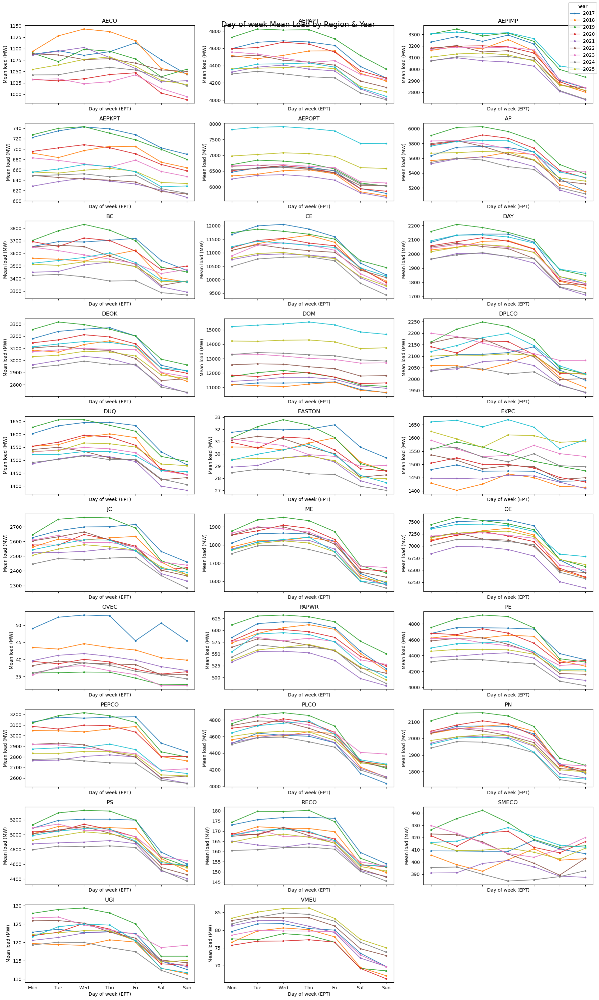

In [11]:
# =========================================================
# 2. DAY-OF-WEEK MEAN LOAD BY REGION & YEAR
# =========================================================

save_dir="EDA_plots/dow_plots"
dow_labels = ["Mon", "Tue", "Wed", "Thu", "Fri", "Sat", "Sun"]

n_regions = len(regions)
ncols = 3
nrows = int(np.ceil(n_regions / ncols))

fig, axes = plt.subplots(
    nrows=nrows, ncols=ncols,
    figsize=(6*ncols, 3*nrows),
    sharex=True, sharey=False
)

axes = np.array(axes).reshape(nrows, ncols)

for idx, region in enumerate(regions):
    r, c = divmod(idx, ncols)
    ax = axes[r, c]

    df_r = df[df["load_area"] == region]

    if df_r.empty:
        ax.set_title(f"{region} (no data)")
        continue

    pos = np.arange(7)  # 0..6 for Mon..Sun

    # Compute only mean load by year and day-of-week
    grp = (
        df_r.groupby(["year_ept", "dow_ept"])["mw"]
            .mean()
            .reset_index()
    )

    years_r = sorted(grp["year_ept"].unique())

    for j, year in enumerate(years_r):
        g = grp[grp["year_ept"] == year].set_index("dow_ept").reindex(range(7))

        ax.plot(
            pos,
            g["mw"],
            marker="o",
            markersize=3,
            alpha=0.9,
            label=str(year)
        )

    ax.set_title(region)
    ax.set_xticks(pos)
    ax.set_xticklabels(dow_labels)
    ax.set_xlabel("Day of week (EPT)")
    ax.set_ylabel("Mean load (MW)")

# Remove unused axes
for k in range(len(regions), nrows * ncols):
    r, c = divmod(k, ncols)
    fig.delaxes(axes[r, c])

# Legend
handles, labels = axes[0, 0].get_legend_handles_labels()
if handles:
    fig.legend(handles, labels, loc="upper right", title="Year")

name="Day-of-week Mean Load by Region & Year"
fig.suptitle("Day-of-week Mean Load by Region & Year", fontsize=16)
plt.tight_layout()
plt.savefig(os.path.join(save_dir, name), dpi=300, bbox_inches="tight")
plt.show()


### Heatmaps to observe Year effects

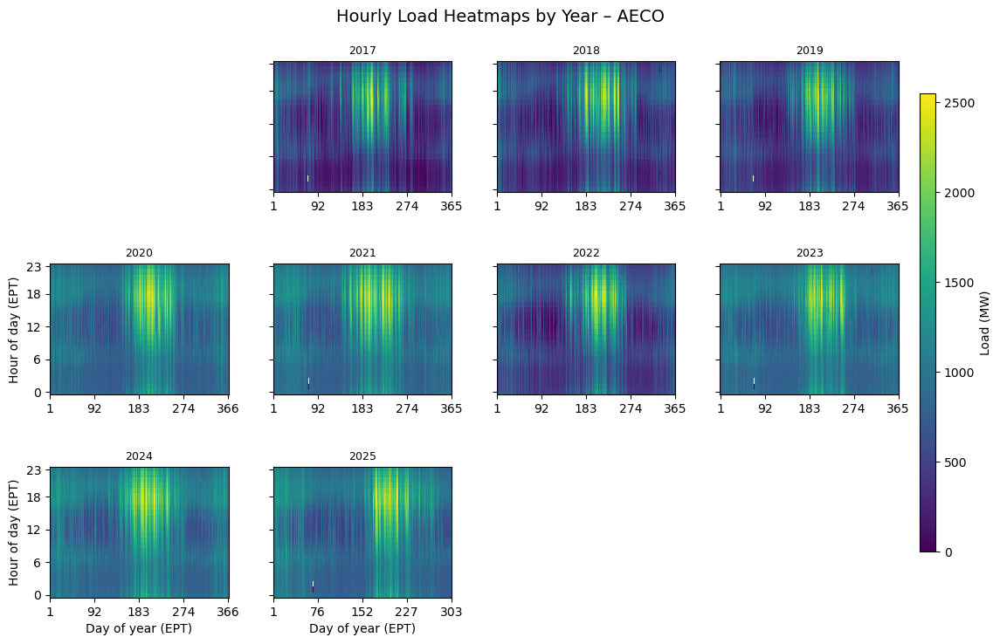

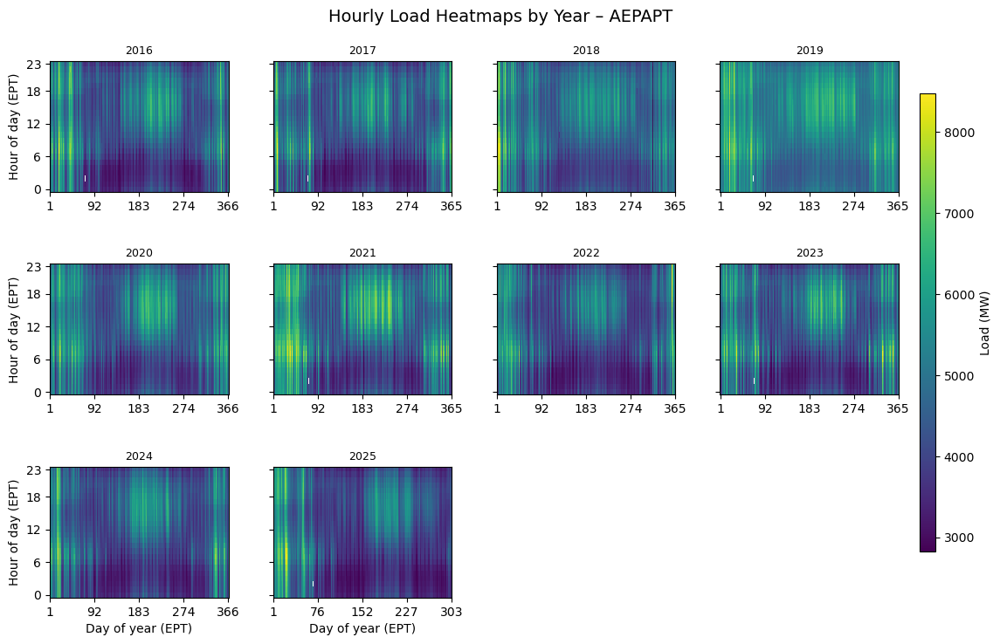

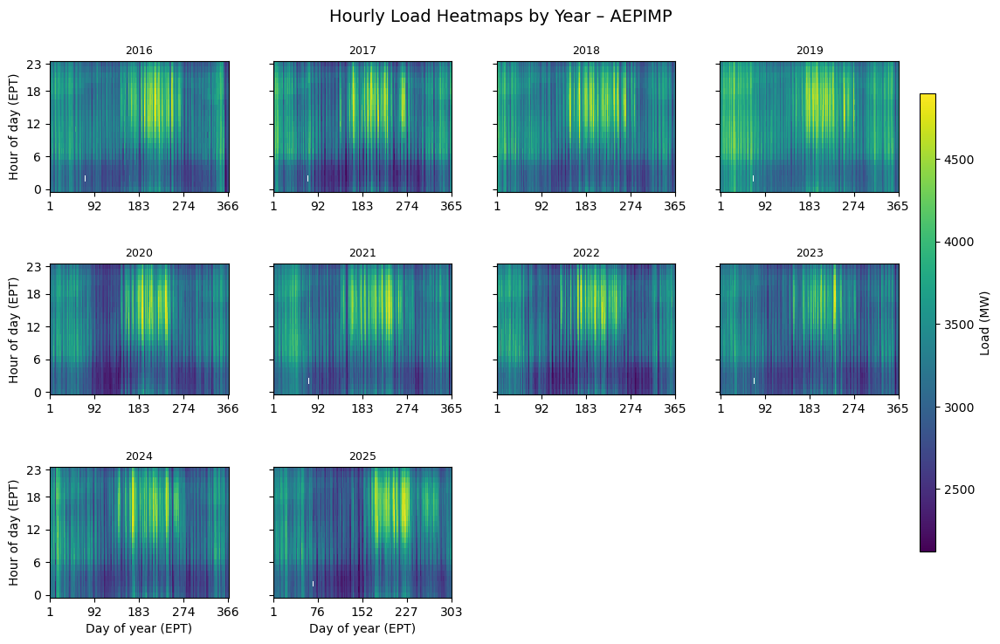

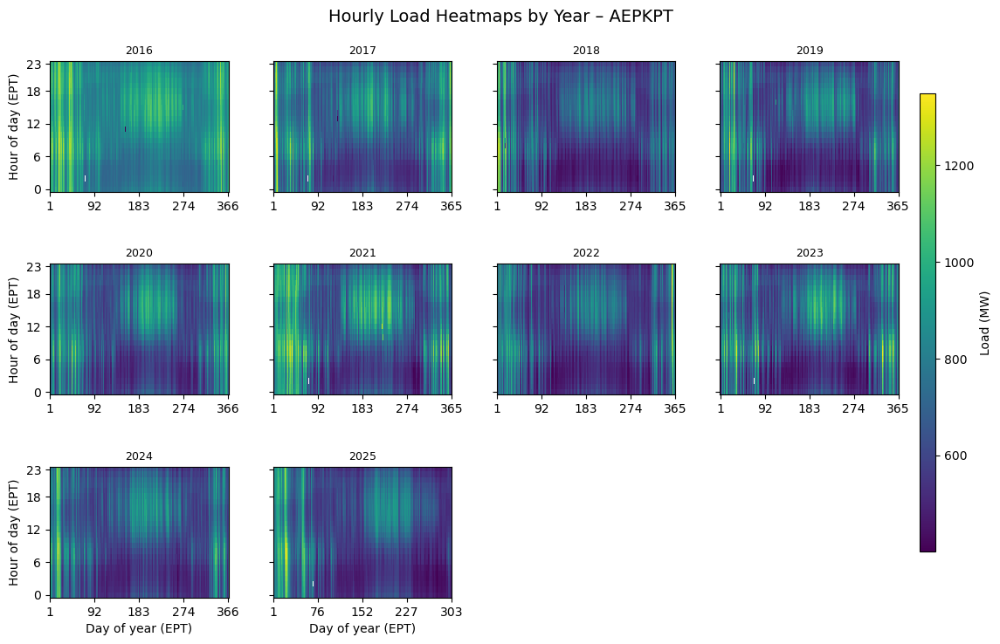

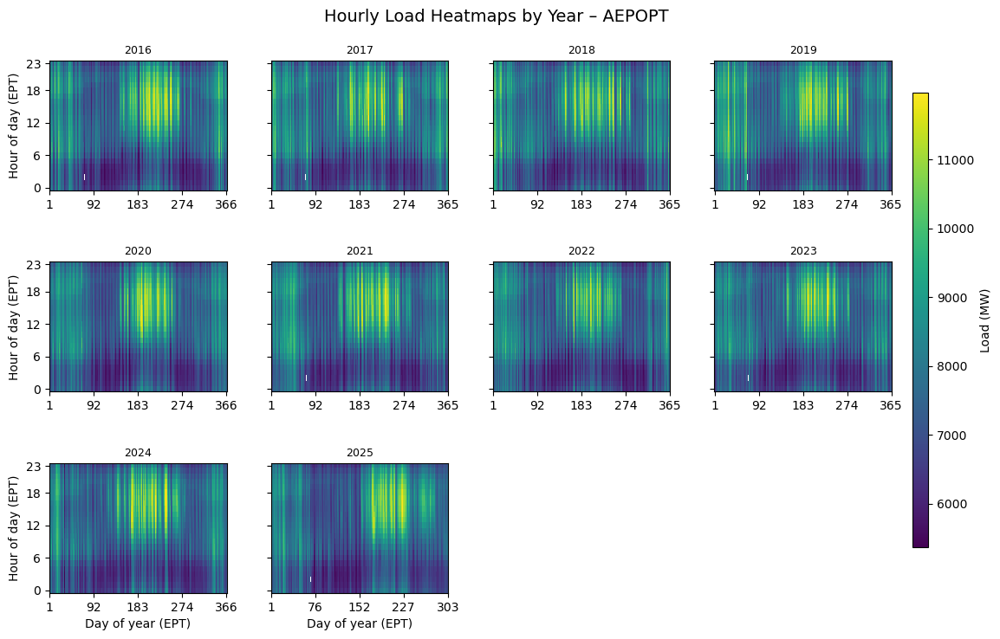

...

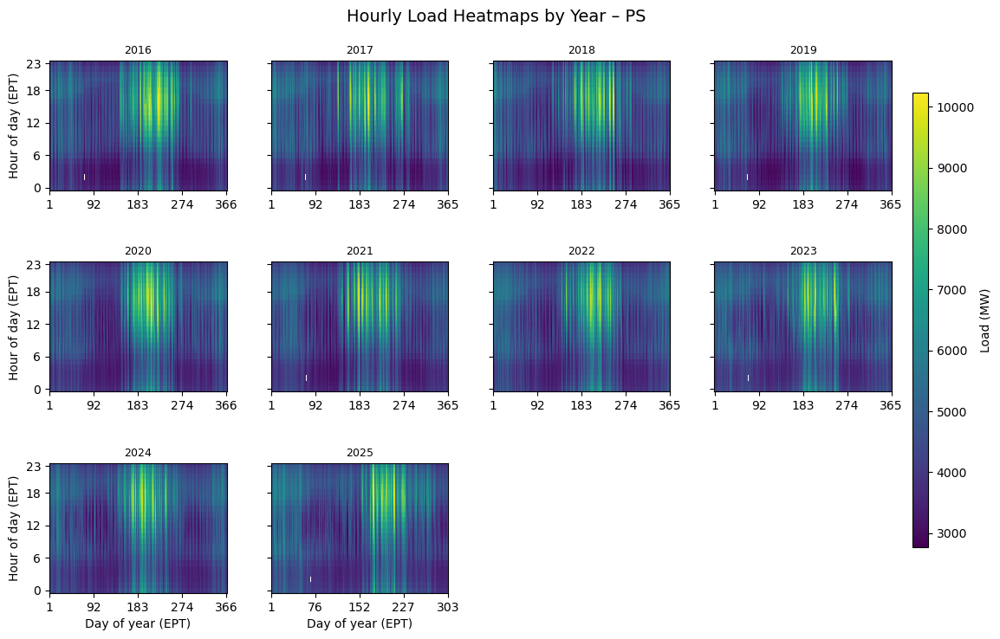

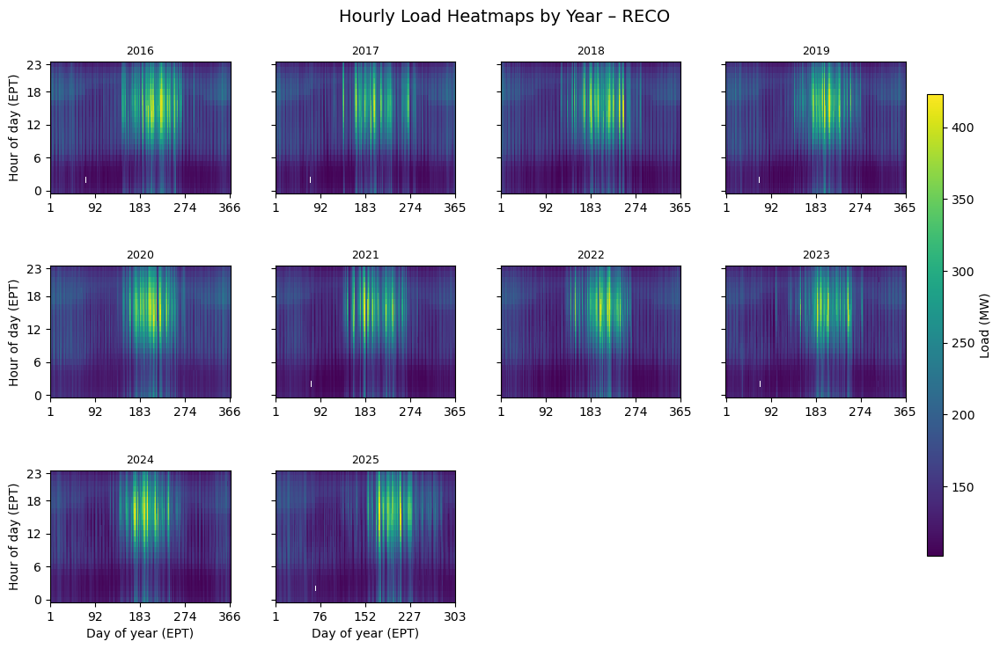

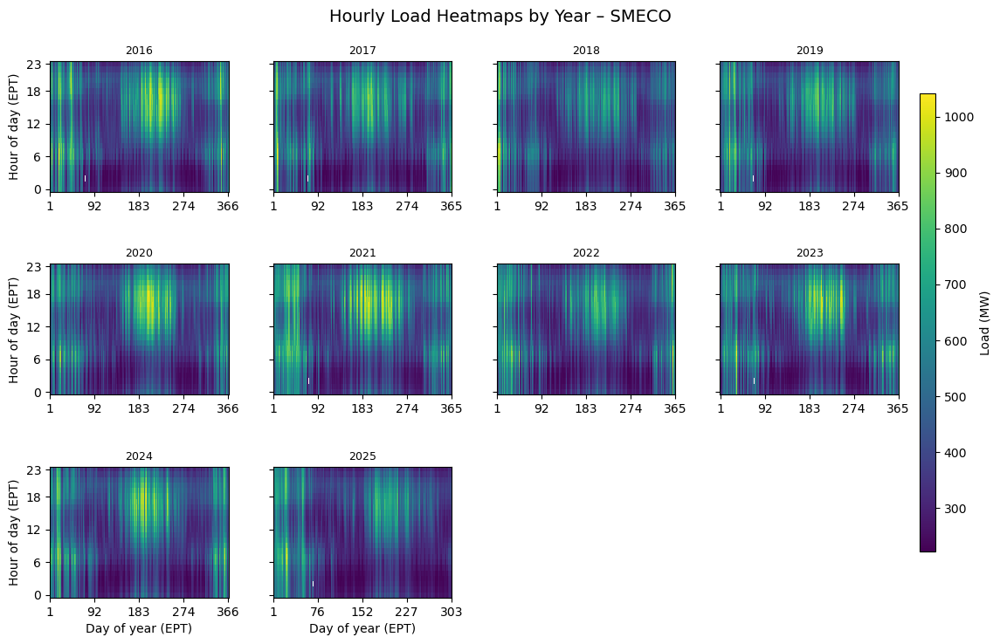

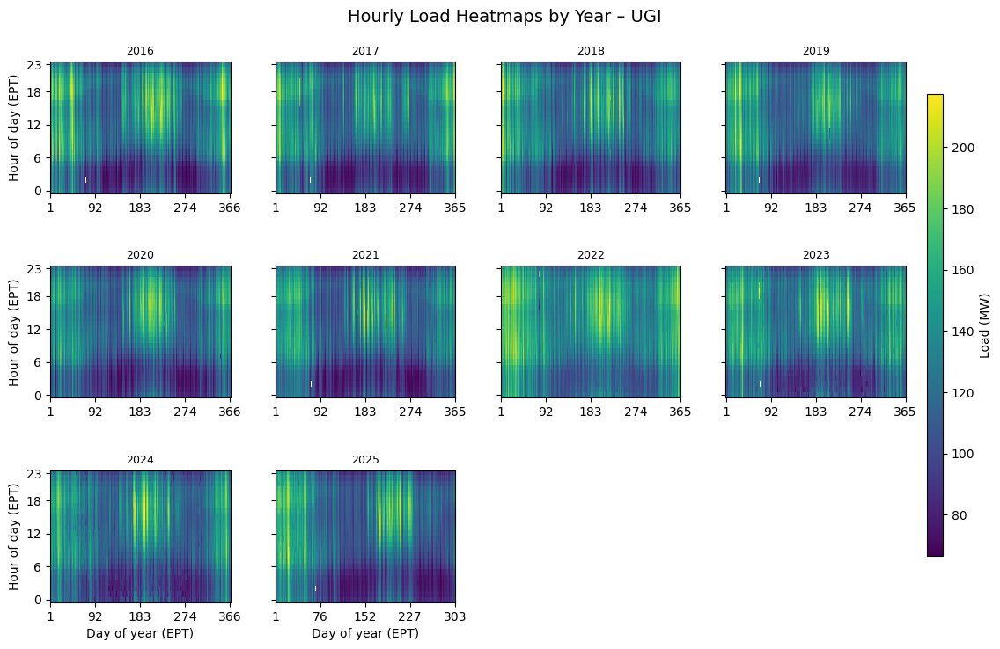

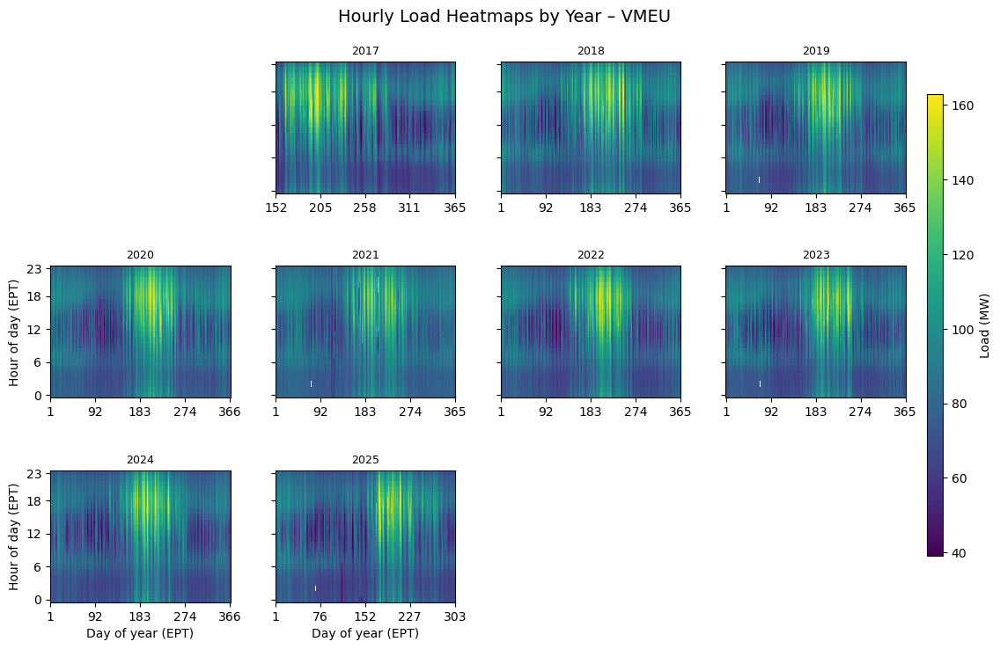

In [12]:
# =========================================================
# 3. HEATMAPS: ONE FIGURE PER REGION, SUBPLOTS OVER YEARS
# =========================================================
save_dir="EDA_plots/heatmaps_per_region"
regions_hm = regions      # or subset like: ["DOM", "AECO", "AEPAPT"]
years_hm   = years        # or a subset of years

for region in regions_hm:
    df_r = df[df["load_area"] == region]
    
    # Skip if no data
    if df_r.empty:
        print(f"No data for region {region}, skipping heatmap.")
        continue
    
    nY = len(years_hm)
    ncols = 4                               # tweak as you like
    nrows = int(np.ceil(nY / ncols))
    
    fig, axes = plt.subplots(
        nrows=nrows, ncols=ncols,
        figsize=(3 * ncols, 2.5 * nrows),
        # IMPORTANT: do NOT share x if each year has different DOY range
        sharex=False,   
        sharey=True
    )
    axes = np.array(axes).reshape(nrows, ncols)

    # Colorbar axis
    cbar_ax = fig.add_axes([0.90, 0.15, 0.015, 0.7])  # [left, bottom, width, height]

    im = None  # will hold the last imshow for the colorbar
    
    for j, year in enumerate(years_hm):
        r, c = divmod(j, ncols)
        ax = axes[r, c]
        
        df_ry = df_r[df_r["year_ept"] == year]
        
        if df_ry.empty:
            ax.set_axis_off()
            continue
        
        pivot = df_ry.pivot_table(
            index="hour_ept",
            columns="doy_ept",
            values="mw",
            aggfunc="mean"
        )
        
        # Actual day-of-year values
        days = pivot.columns.values
        
        # Optional debug: check range per year
        # print(region, year, "DOY range:", days.min(), days.max())
        
        # Correct DOY scaling
        im = ax.imshow(
            pivot.values,
            aspect="auto",
            origin="lower",
            interpolation="none",
            extent=[
                days.min() - 0.5,
                days.max() + 0.5,
                pivot.index.min() - 0.5,
                pivot.index.max() + 0.5
            ]
        )
        
        # Dynamic ticks per subplot
        xticks = np.linspace(days.min(), days.max(), 5, dtype=int)
        ax.set_xticks(xticks)
        ax.set_xticklabels(xticks)
        
        ax.set_title(str(year), fontsize=9)
        ax.set_yticks([0, 6, 12, 18, 23])
        ax.set_yticklabels([0, 6, 12, 18, 23])
        
    # Turn off any unused axes (if years don't fill the grid)
    for k in range(nY, nrows * ncols):
        r, c = divmod(k, ncols)
        axes[r, c].set_axis_off()
    
    # Common labels
    for r in range(nrows):
        for c in range(ncols):
            ax = axes[r, c]
            if r == nrows - 1 and ax.has_data():
                ax.set_xlabel("Day of year (EPT)")
            if c == 0 and ax.has_data():
                ax.set_ylabel("Hour of day (EPT)")
    
    # Colorbar for this region's figure
    if im is not None:
        cbar = fig.colorbar(im, cax=cbar_ax)
        cbar.set_label("Load (MW)")
    name=f"Hourly Load Heatmaps by Year – {region}"
    fig.suptitle(f"Hourly Load Heatmaps by Year – {region}", fontsize=14)
    fig.subplots_adjust(
    left=0.07,
    right=0.88,
    bottom=0.08,
    top=0.90,
    hspace=0.55,   # ← INCREASE THIS VALUE
    wspace=0.25
    )
    plt.savefig(os.path.join(save_dir, name), dpi=300, bbox_inches="tight")
    plt.show()


## Weather Data Extraction

We saw direct effects of season, so below we download open-source weather data from open-meteo. 

In [84]:
import os
import glob
from datetime import datetime
import time
import requests

import numpy as np
import pandas as pd
from pandas.api.types import is_numeric_dtype
import warnings

warnings.filterwarnings(
    "ignore",
    message=".*StringArray.*_reduce.*",
    category=FutureWarning
)

# ==========================
# 0. Load-area coordinates
# ==========================
zone_coords = pd.DataFrame({
    'load_area': ['AECO', 'AEPAPT', 'AEPIMP', 'AEPKPT', 'AEPOPT', 'AP', 'BC', 'CE', 'DAY', 'DEOK',
                  'DOM', 'DPLCO', 'DUQ', 'EASTON', 'EKPC', 'JC', 'ME', 'OE', 'OVEC', 'PAPWR',
                  'PE', 'PEPCO', 'PLCO', 'PN', 'PS', 'RECO', 'SMECO', 'UGI', 'VMEU'],
    'lat': [39.45, 37.25, 38.45, 38.20, 39.90, 37.30, 40.80, 41.85, 39.75, 39.10,
            37.55, 38.90, 40.45, 39.55, 37.75, 40.35, 40.20, 41.10, 38.85, 40.70,
            40.00, 38.90, 40.95, 41.15, 40.75, 41.00, 38.40, 40.25, 37.30],
    'lon': [-74.50, -81.30, -81.60, -83.10, -82.90, -80.90, -79.95, -86.10, -84.20, -84.50,
            -77.45, -75.50, -79.90, -75.10, -84.30, -74.65, -76.00, -81.25, -82.85, -77.80,
            -75.20, -76.95, -77.40, -77.80, -74.15, -74.10, -76.70, -75.65, -76.00]
})

print(f"Total load areas: {len(zone_coords)}")
zone_coords.head()

# Year range to download
years = list(range(2016, 2026))

# API endpoint
api = "https://archive-api.open-meteo.com/v1/archive"

# Weather variables to retrieve
hourly_vars = "temperature_2m,relative_humidity_2m,dew_point_2m,precipitation,wind_speed_10m"

# Create output directory
# Create output directory (single source of truth)
WEATHER_DIR = "data/raw/weather_raw"
os.makedirs(WEATHER_DIR, exist_ok=True)

print(f"Years to download: {years[0]} - {years[-1]}")
print(f"Variables: {hourly_vars}")

def month_seq(year):
    """Generate first day of each month for a given year"""
    return [datetime(year, m, 1).date() for m in range(1, 13)]

def fetch_month(lat, lon, start_date, end_date, tries=3):
    """Fetch weather data for a specific month and location"""
    url = (f"{api}?latitude={lat}&longitude={lon}&start_date={start_date}"
           f"&end_date={end_date}&hourly={hourly_vars}&timezone=UTC")
    
    for k in range(1, tries + 1):
        try:
            res = requests.get(url, timeout=60)
            if res.status_code == 200:
                j = res.json()
                if 'hourly' in j and 'time' in j['hourly']:
                    return pd.DataFrame({
                        'datetime_beginning_utc': j['hourly']['time'],
                        'temp': j['hourly']['temperature_2m'],
                        'humidity': j['hourly']['relative_humidity_2m'],
                        'dew_point': j['hourly']['dew_point_2m'],
                        'precip': j['hourly']['precipitation'],
                        'wind': j['hourly']['wind_speed_10m']
                    })
        except Exception as e:
            print(f"Error on attempt {k}: {e}")
        
        time.sleep(0.7 * k)
    
    return None

for y in years:
    print(f"\n{'='*50}")
    print(f"Processing year {y} ...")
    print(f"{'='*50}")

    # --------------------------------------
    # NEW: Skip downloading if file exists
    # --------------------------------------
    output_file = os.path.join("data/raw/weather_raw", f"weather_hourly_{y}.csv")
    if os.path.exists(output_file):
        print(f"✓ File already exists → Skipping download: {output_file}")
        continue

    out = []
    
    for idx, row in zone_coords.iterrows():
        la = row['load_area']
        lat = row['lat']
        lon = row['lon']
        
        print(f"Processing {la} ({idx+1}/{len(zone_coords)})...", end=' ')
        
        for m in month_seq(y):
            # Skip future months
            if m > datetime.now().date():
                continue
            
            # Calculate end of month
            nxt = m + relativedelta(months=1)
            m_end = min(nxt - timedelta(days=1), datetime.now().date())
            
            # Fetch weather data
            w = fetch_month(lat, lon, str(m), str(m_end))
            
            if w is not None:
                # ---- Convert UTC → ET ----
                w['datetime_beginning_utc'] = w['datetime_beginning_utc'].apply(
                    lambda x: f"{x}:00" if len(x.split(':')) == 2 else x
                )
                
                utc_times = pd.to_datetime(w['datetime_beginning_utc'], format='%Y-%m-%dT%H:%M:%S')
                utc_times = utc_times.dt.tz_localize('UTC')
                et_times = utc_times.dt.tz_convert('America/New_York')
                
                w['datetime_beginning_ept'] = et_times.dt.strftime('%Y-%m-%d %H:%M:%S')
                w['load_area'] = la
                
                out.append(w)
            
            time.sleep(0.15)
        
        print("Done")
    
    # ---- Write CSV ----
    if out:
        df = pd.concat(out, ignore_index=True)
        df = df.sort_values(['datetime_beginning_utc', 'load_area'])
        
        df.to_csv(output_file, index=False)
        print(f"\n✓ Saved {output_file} ({len(df):,} rows)")
print("\n" + "="*50)
print("Done! Files saved in ./data/weather_raw/weather_hourly_YYYY.csv")
print("="*50)

Total load areas: 29
Years to download: 2016 - 2025
Variables: temperature_2m,relative_humidity_2m,dew_point_2m,precipitation,wind_speed_10m

Processing year 2016 ...
✓ File already exists → Skipping download: data/raw/weather_raw/weather_hourly_2016.csv

Processing year 2017 ...
✓ File already exists → Skipping download: data/raw/weather_raw/weather_hourly_2017.csv

Processing year 2018 ...
✓ File already exists → Skipping download: data/raw/weather_raw/weather_hourly_2018.csv

Processing year 2019 ...
✓ File already exists → Skipping download: data/raw/weather_raw/weather_hourly_2019.csv

Processing year 2020 ...
✓ File already exists → Skipping download: data/raw/weather_raw/weather_hourly_2020.csv

Processing year 2021 ...
✓ File already exists → Skipping download: data/raw/weather_raw/weather_hourly_2021.csv

Processing year 2022 ...
✓ File already exists → Skipping download: data/raw/weather_raw/weather_hourly_2022.csv

Processing year 2023 ...
✓ File already exists → Skipping do

### Merging weather data and some preprocessing

In [33]:
import os
import pandas as pd

# --- paths ---
WEATHER_DIR = "data/raw/weather_raw"
LOAD_DIR    = "data/processed"
OUT_DIR     = "data/merged"

# create merged folder if it doesn't exist
os.makedirs(OUT_DIR, exist_ok=True)

years = range(2016, 2026)   # 2016–2025 inclusive

for year in years:
    weather_path = os.path.join(WEATHER_DIR, f"weather_hourly_{year}.csv")
    load_path    = os.path.join(LOAD_DIR,    f"hrl_load_metered_{year}.csv")
    out_path     = os.path.join(OUT_DIR,     f"pjm_load_weather_{year}.csv")

    if not os.path.exists(weather_path):
        print(f"[{year}] Missing weather file: {weather_path} — skipping")
        continue
    if not os.path.exists(load_path):
        print(f"[{year}] Missing load file: {load_path} — skipping")
        continue

    # --- read files ---
    weather = pd.read_csv(weather_path)
    load    = pd.read_csv(load_path)

    # --- align on UTC hour ---
    # weather: datetime_beginning_utc
    weather["dt_utc"] = pd.to_datetime(weather["datetime_beginning_utc"], utc=True)

    # load: use ts_utc (already UTC); fall back to datetime_beginning_utc if needed
    if "ts_utc" in load.columns:
        load["dt_utc"] = pd.to_datetime(load["ts_utc"], utc=True)
    else:
        load["dt_utc"] = pd.to_datetime(load["datetime_beginning_utc"], utc=True)

    # clean load_area strings just in case
    for df in (weather, load):
        df["load_area"] = df["load_area"].astype(str).str.strip()

    # --- merge on UTC hour + load area ---
    merged = pd.merge(
        load,
        weather,
        how="left",
        on=["dt_utc", "load_area"],
        suffixes=("_load", "_wx")  # handle overlapping column names
    )

    # --- save ---
    merged.to_csv(out_path, index=False)
    print(f"[{year}] Saved merged file: {out_path}  shape={merged.shape}")


[2016] Saved merged file: data/merged/pjm_load_weather_2016.csv  shape=(228384, 23)
[2017] Saved merged file: data/merged/pjm_load_weather_2017.csv  shape=(241657, 23)
[2018] Saved merged file: data/merged/pjm_load_weather_2018.csv  shape=(246024, 23)
[2019] Saved merged file: data/merged/pjm_load_weather_2019.csv  shape=(254040, 23)
[2020] Saved merged file: data/merged/pjm_load_weather_2020.csv  shape=(254736, 23)
[2021] Saved merged file: data/merged/pjm_load_weather_2021.csv  shape=(254040, 23)
[2022] Saved merged file: data/merged/pjm_load_weather_2022.csv  shape=(254040, 23)
[2023] Saved merged file: data/merged/pjm_load_weather_2023.csv  shape=(254040, 23)
[2024] Saved merged file: data/merged/pjm_load_weather_2024.csv  shape=(254736, 23)
[2025] Saved merged file: data/merged/pjm_load_weather_2025.csv  shape=(210859, 23)


In [35]:
import os
import pandas as pd

MERGED_DIR = "data/merged"
years = range(2016, 2026)

# mapping of old → new column names
rename_map = {
    "temp": "temperature_2m",
    "humidity": "relative_humidity_2m",
    "wind": "wind_speed_10m",
    "precip": "precipitation",
}

for year in years:
    path = os.path.join(MERGED_DIR, f"pjm_load_weather_{year}.csv")
    
    if not os.path.exists(path):
        print(f"[{year}] Missing merged file — skipping")
        continue

    df = pd.read_csv(path)

    # rename only the columns that exist
    df = df.rename(columns=rename_map)

    # overwrite same file
    df.to_csv(path, index=False)

    print(f"[{year}] Updated columns and overwritten file.")


[2016] Updated columns and overwritten file.
[2017] Updated columns and overwritten file.
[2018] Updated columns and overwritten file.
[2019] Updated columns and overwritten file.
[2020] Updated columns and overwritten file.
[2021] Updated columns and overwritten file.
[2022] Updated columns and overwritten file.
[2023] Updated columns and overwritten file.
[2024] Updated columns and overwritten file.
[2025] Updated columns and overwritten file.


## Task 1: Model hourly loads - OLS Regression with Feature Engineering

Due to periodicity across days,weeks and years, we engineer appropriate features and train a simple OLS regression model with a few interaction terms.

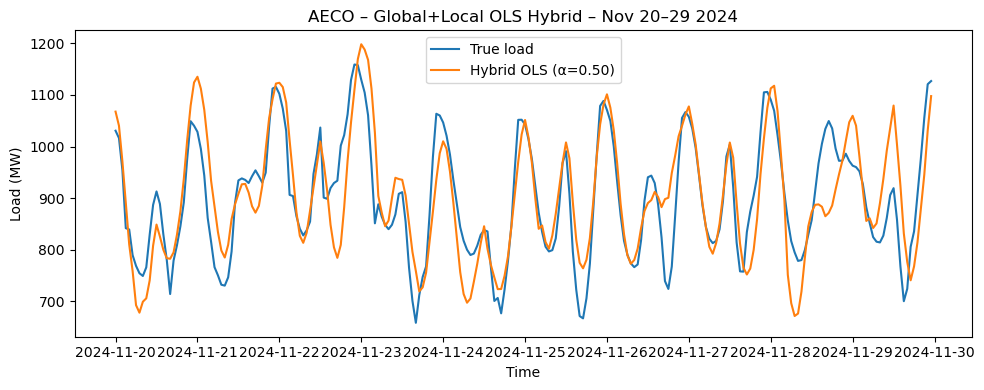

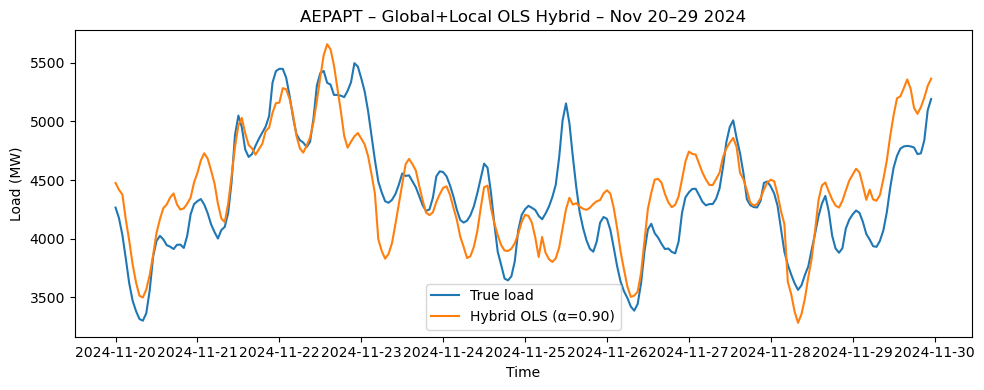

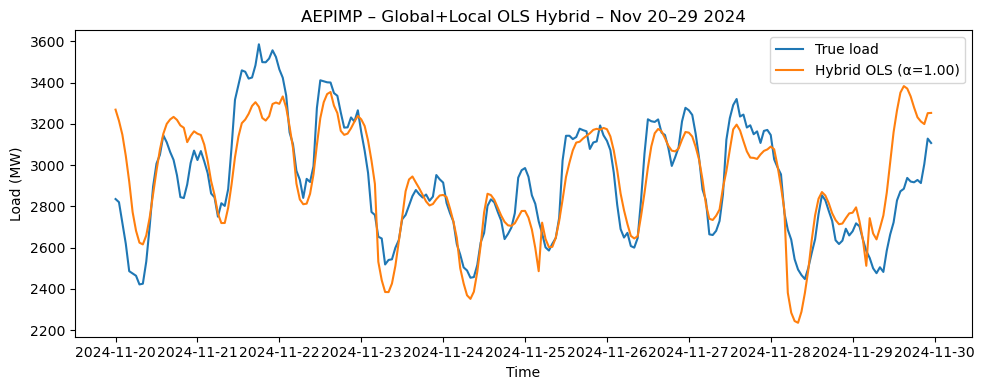

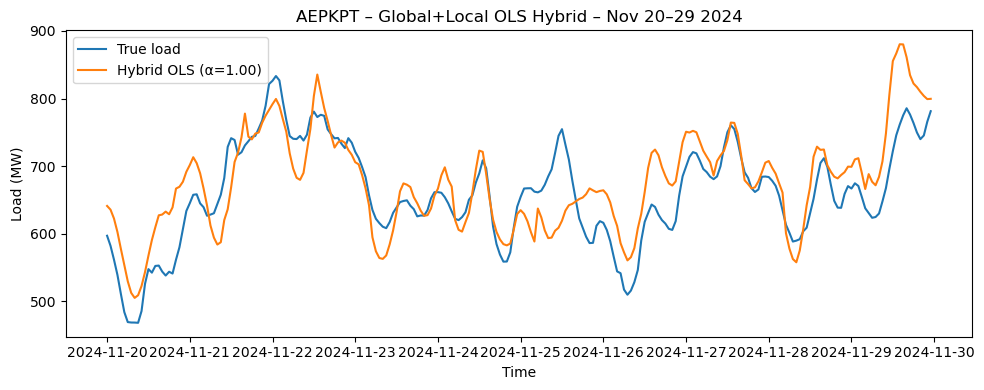

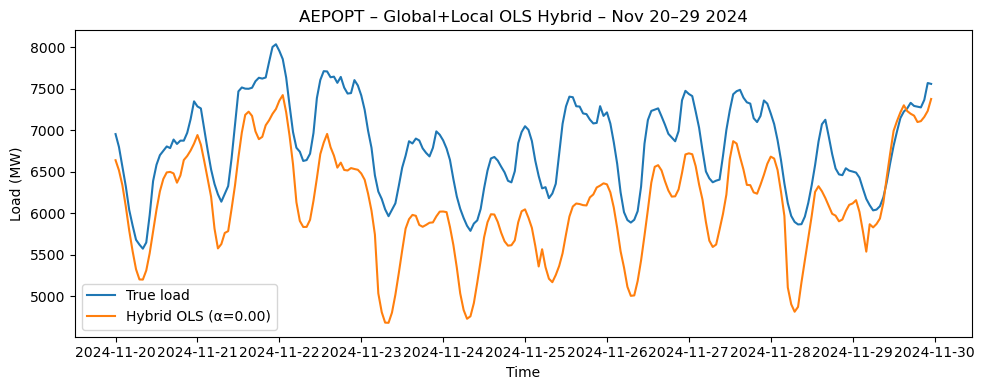

...

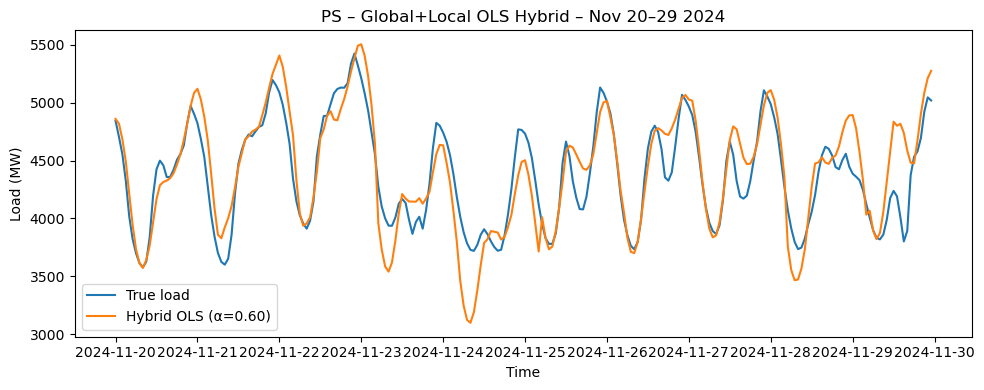

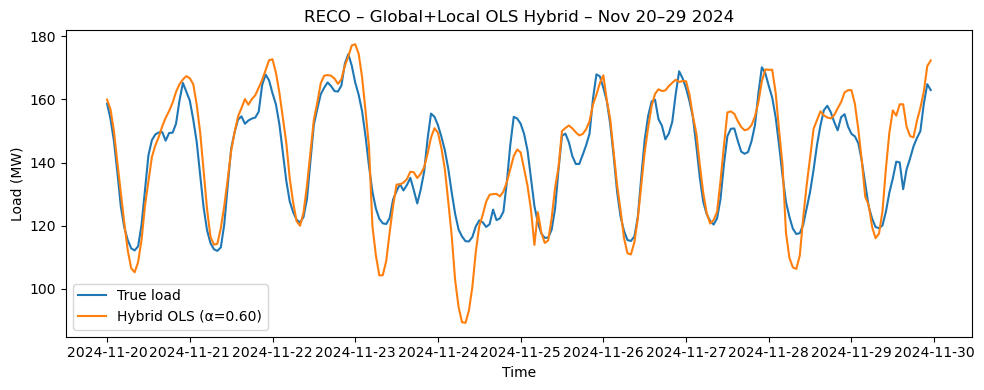

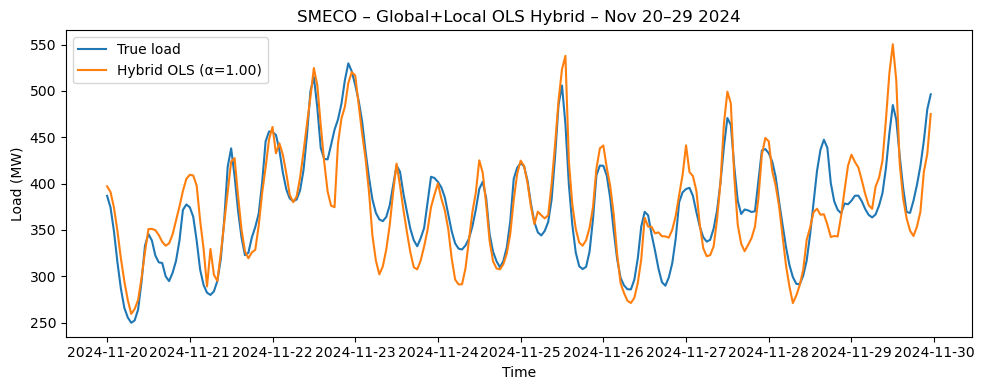

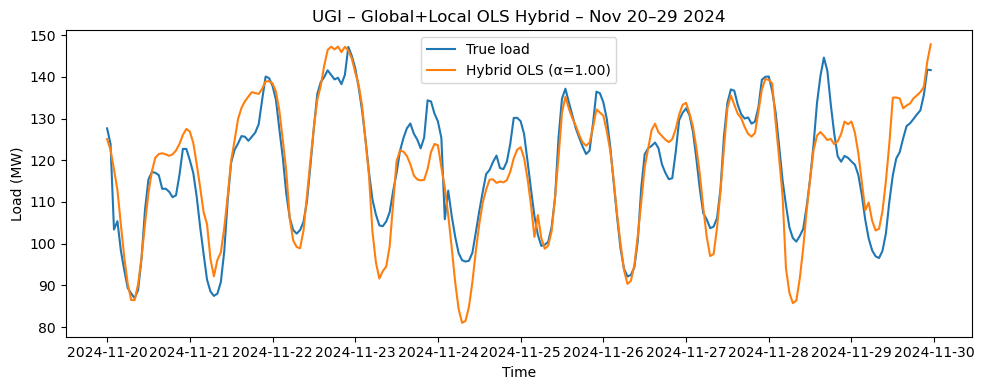

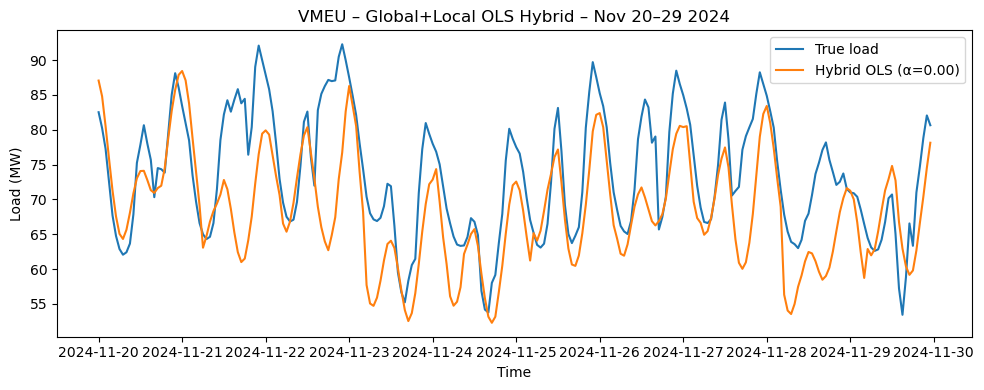

Saved Task 1 models to models/task1_models.pkl


,load_area,best_alpha,mse,rmse,n_test
0,AECO,0.5,4.952431e+03,70.373512,240
1,AEPAPT,0.9,8.635354e+04,293.859727,240
2,AEPIMP,1.0,2.676745e+04,163.607609,240
3,AEPKPT,1.0,2.393352e+03,48.921893,240
4,AEPOPT,0.0,5.862368e+05,765.660993,240
5,AP,0.7,8.262191e+04,287.440276,240
6,BC,1.0,6.973320e+04,264.070450,240
7,CE,1.0,2.240963e+05,473.388092,240
8,DAY,0.7,1.004087e+04,100.204153,240
9,DEOK,0.6,2.257682e+04,150.255841,240


In [119]:
from pathlib import Path
from joblib import dump

MODEL_DIR = Path("models")
MODEL_DIR.mkdir(exist_ok=True)

import glob
from pathlib import Path

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from pandas.tseries.offsets import Week

# -----------------------------
# Load merged data up to 2024
# -----------------------------
csv_files = sorted(glob.glob("data/merged/pjm_load_weather_*.csv"))
df_list = []
for f in csv_files:
    year = int(f.split("_")[-1].split(".")[0])
    if year > 2024:
        continue
    tmp = pd.read_csv(f)
    df_list.append(tmp)

df = pd.concat(df_list, ignore_index=True)

# -----------------------------
# Basic time handling
# -----------------------------
df["ts_utc"] = pd.to_datetime(df["ts_utc"])
df = df.sort_values("ts_utc").set_index("ts_utc")

df["date_ept"] = pd.to_datetime(df["date_ept"])
df["hour_ept"] = df["hour_ept"].astype(int)
df["dow_ept"]  = df["dow_ept"].astype(int)
df["month"]    = df["date_ept"].dt.month

# -----------------------------
# Meteorological season
# -----------------------------
def meteorological_season(dt):
    m = dt.month
    if m in (12, 1, 2):
        return "winter"
    elif m in (3, 4, 5):
        return "spring"
    elif m in (6, 7, 8):
        return "summer"
    else:
        return "autumn"

df["season"] = df["date_ept"].apply(meteorological_season)

# -----------------------------
# Month as categorical  # NEW
# -----------------------------
df["month"] = df["month"].astype("category")

# -----------------------------
# Thanksgiving features  # NEW
# -----------------------------
years = df["date_ept"].dt.year.unique()

thanksgiving_dates = {}
for y in years:
    # 4th Thursday of November for year y
    base = pd.Timestamp(y, 11, 1)
    first_thu = base + Week(weekday=3)      # first Thursday on/after Nov 1
    thanksgiving_dates[y] = first_thu + Week(3)  # + 3 weeks = 4th Thursday

def is_thanksgiving(date):
    return int(date.normalize() == thanksgiving_dates[date.year].normalize())

def is_thanksgiving_week(date):
    tg = thanksgiving_dates[date.year]
    return int((date.normalize() >= (tg - pd.Timedelta(days=3))) &
               (date.normalize() <= (tg + pd.Timedelta(days=2))))

df["is_thanksgiving"] = df["date_ept"].apply(is_thanksgiving).astype(int)
df["is_thanksgiving_week"] = df["date_ept"].apply(is_thanksgiving_week).astype(int)

# -----------------------------
# Daily harmonics (orders 1–2)
# -----------------------------
h = df["hour_ept"].values
for k in [1, 2]:
    df[f"sin_h{k}"] = np.sin(2 * np.pi * k * h / 24.0)
    df[f"cos_h{k}"] = np.cos(2 * np.pi * k * h / 24.0)

# -----------------------------
# Weekly harmonics (optional but included)
# dow_ept: 0..6 as numeric
# -----------------------------
dow_num = df["dow_ept"].astype(int).values
df["sin_dow"] = np.sin(2 * np.pi * dow_num / 7.0)
df["cos_dow"] = np.cos(2 * np.pi * dow_num / 7.0)


df["doy"] = df["date_ept"].dt.dayofyear
df["sin_doy"] = np.sin(2 * np.pi * df["doy"] / 365)
df["cos_doy"] = np.cos(2 * np.pi * df["doy"] / 365)

# -----------------------------
# Weather features + piecewise temps
# -----------------------------
T = df["temperature_2m"]
df["temp2"]      = T ** 2
df["temp_cool"]  = np.maximum(T - 65.0, 0)   # cooling above 65°F
df["temp_heat"]  = np.maximum(45.0 - T, 0)   # heating below 45°F

# simple interactions with first harmonic
df["temp_cool_sin_h1"] = df["temp_cool"] * df["sin_h1"]
df["temp_cool_cos_h1"] = df["temp_cool"] * df["cos_h1"]
df["temp_heat_sin_h1"] = df["temp_heat"] * df["sin_h1"]
df["temp_heat_cos_h1"] = df["temp_heat"] * df["cos_h1"]

# Cast categoricals
df["season"]  = df["season"].astype("category")
df["dow_ept"] = df["dow_ept"].astype("category")

load_col = "mw"
area_col = "load_area"

def make_global_ols_pipeline():
    """
    Global OLS model:
      y ~ daily harmonics (order 1–2) + weekly harmonics +
          temp, temp^2, temp_cool, temp_heat +
          humidity, wind, precip +
          temp_cool/temp_heat × sin_h1/cos_h1 +
          dow dummies + season dummies + month dummies +
          Thanksgiving indicators
    """
    num_features = [
        "sin_h1", "cos_h1",
        "sin_h2", "cos_h2",
        "sin_dow", "cos_dow",
        "sin_doy","cos_doy",
        "temperature_2m",
        "temp2",
        "temp_cool",
        "temp_heat",
        "relative_humidity_2m",
        "wind_speed_10m",
        "precipitation",
        "temp_cool_sin_h1",
        "temp_cool_cos_h1",
        "temp_heat_sin_h1",
        "temp_heat_cos_h1",
        "is_thanksgiving",        # NEW
        "is_thanksgiving_week",   # NEW
    ]
    cat_features = ["dow_ept", "season", "month"]   # NEW: month as categorical

    numeric_transformer = Pipeline(steps=[
        ("scaler", StandardScaler())
    ])

    categorical_transformer = OneHotEncoder(drop="first", handle_unknown="ignore")

    preprocessor = ColumnTransformer(
        transformers=[
            ("num", numeric_transformer, num_features),
            ("cat", categorical_transformer, cat_features),
        ]
    )

    ols = LinearRegression()

    pipe = Pipeline(steps=[
        ("preprocess", preprocessor),
        ("reg", ols),
    ])
    return pipe, num_features, cat_features


def make_local_ols_pipeline():
    """
    Local OLS model (late-autumn behavior):
      y ~ daily harmonics (1–2) +
          temp, temp^2, temp_cool, temp_heat +
          temp_cool/temp_heat × sin_h1/cos_h1 +
          dow dummies + month dummies +
          Thanksgiving indicators
    """
    num_features = [
        "sin_h1", "cos_h1",
        "sin_h2", "cos_h2",
        "sin_dow", "cos_dow",
        "sin_doy","cos_doy",
        "temperature_2m",
        "temp2",
        "temp_cool",
        "temp_heat",
        "relative_humidity_2m",
        "temp_cool_sin_h1",
        "temp_cool_cos_h1",
        "temp_heat_sin_h1",
        "temp_heat_cos_h1",
        "is_thanksgiving",        # NEW
        "is_thanksgiving_week",   # NEW
    ]
    cat_features = ["dow_ept", "month"]           # NEW: month as categorical

    numeric_transformer = Pipeline(steps=[
        ("scaler", StandardScaler())
    ])

    categorical_transformer = OneHotEncoder(drop="first", handle_unknown="ignore")

    preprocessor = ColumnTransformer(
        transformers=[
            ("num", numeric_transformer, num_features),
            ("cat", categorical_transformer, cat_features),
        ]
    )

    ols = LinearRegression()

    pipe = Pipeline(steps=[
        ("preprocess", preprocessor),
        ("reg", ols),
    ])
    return pipe, num_features, cat_features

# train_end  = pd.Timestamp("2024-11-19 23:00:00")
# test_start = pd.Timestamp("2024-11-20 00:00:00")
# test_end   = pd.Timestamp("2024-11-29 23:00:00")

train_end  = pd.Timestamp("2024-11-19 23:00:00", tz="UTC")
test_start = pd.Timestamp("2024-11-20 00:00:00", tz="UTC")
test_end   = pd.Timestamp("2024-11-29 23:00:00", tz="UTC")


alpha_grid = np.linspace(0, 1, 11)   # 0, 0.1, ..., 1

fig_dir = Path("figures_global_local_OLS_improved")
fig_dir.mkdir(exist_ok=True)

task1_models = {}
results = []

for area_name, df_area in df.groupby(area_col):

    df_area = df_area.sort_index().copy()
    first_year = df_area.index.year.min()
    #train_start = pd.Timestamp(f"{first_year}-01-01 00:00:00", tz=None)
    train_start = pd.Timestamp(f"{first_year}-01-01 00:00:00", tz="UTC")

    # ---------- GLOBAL TRAIN ----------
    df_global = df_area[(df_area.index >= train_start) & (df_area.index <= train_end)]
    if df_global.empty:
        print(f"[Improved OLS] Skip {area_name}: no global training data.")
        continue

    global_pipe, g_num, g_cat = make_global_ols_pipeline()
    # NEW: drop rows with NaNs in any feature or the target
    df_global = df_global.dropna(subset=g_num + g_cat + [load_col])
    if df_global.empty:
        print(f"[Improved OLS] Skip {area_name}: no clean global data after dropna.")
        continue
    Xg = df_global[g_num + g_cat]
    yg = df_global[load_col].astype(float)
    global_pipe.fit(Xg, yg)

    # ---------- LOCAL TRAIN (Sept–Nov, years <= 2023) ----------
    mask_local = (
        (df_area.index.year <= 2023) &
        (df_area["date_ept"].dt.month.isin([9, 10, 11]))
    )
    df_local = df_area[mask_local]
    if df_local.empty:
        print(f"[Improved OLS] Skip local for {area_name}: no Sept–Nov data <= 2023.")
        continue

    local_pipe, l_num, l_cat = make_local_ols_pipeline()
    # NEW: drop rows with NaNs in any feature or the target
    df_local= df_local.dropna(subset=l_num + l_cat + [load_col])
    if df_local.empty:
        print(f"[Improved OLS] Skip local for {area_name}: no clean local data after dropna.")
        continue

    Xl = df_local[l_num + l_cat]
    yl = df_local[load_col].astype(float)
    local_pipe.fit(Xl, yl)

    # ---------- TEST (Nov 20–29 2024) ----------
    df_test = df_area[(df_area.index >= test_start) & (df_area.index <= test_end)]
    if df_test.empty:
        print(f"[Improved OLS] Skip test for {area_name}: no Nov20–29 2024 data.")
        continue

    X_test_global = df_test[g_num + g_cat]
    X_test_local  = df_test[l_num + l_cat]
    y_test = df_test[load_col].astype(float)

    y_pred_global = global_pipe.predict(X_test_global)
    y_pred_local  = local_pipe.predict(X_test_local)

    # ---------- Convex combination over alpha ----------
    best_alpha = None
    best_mse   = np.inf
    best_pred  = None

    for alpha in alpha_grid:
        y_pred_hybrid = alpha * y_pred_global + (1 - alpha) * y_pred_local
        mse = mean_squared_error(y_test, y_pred_hybrid)
        if mse < best_mse:
            best_mse = mse
            best_alpha = alpha
            best_pred = y_pred_hybrid

    rmse = np.sqrt(best_mse)

    results.append({
        "load_area": area_name,
        "best_alpha": best_alpha,
        "mse": best_mse,
        "rmse": rmse,
        "n_test": len(y_test),
    })

    task1_models[area_name] = {
        "global_pipe": global_pipe,
        "local_pipe":  local_pipe,
        "alpha":       float(best_alpha),
        "g_num":       g_num,
        "g_cat":       g_cat,
        "l_num":       l_num,
        "l_cat":       l_cat,
    }

    # ---------- Plot true vs hybrid prediction ----------
    plt.figure(figsize=(10, 4))
    plt.plot(df_test.index, y_test.values, label="True load", linewidth=1.5)
    plt.plot(df_test.index, best_pred,
             label=f"Hybrid OLS (α={best_alpha:.2f})", linewidth=1.5)
    plt.title(f"{area_name} – Global+Local OLS Hybrid – Nov 20–29 2024")
    plt.xlabel("Time")
    plt.ylabel("Load (MW)")
    plt.legend()
    plt.tight_layout()
    plt.savefig(fig_dir / f"{area_name}_global_local_OLS_improved_Nov20_29_2024.png", dpi=150)
    plt.show()

results_df = pd.DataFrame(results).sort_values("load_area")
dump(task1_models, MODEL_DIR / "task1_models.pkl")
print("Saved Task 1 models to", MODEL_DIR / "task1_models.pkl")
results_df

In [47]:
# Ensure results_df exists from the improved OLS hybrid model

# Drop any areas that failed (if rmse is NaN)
valid_results = results_df.dropna(subset=["rmse"])

# Average RMSE across load areas
avg_rmse = valid_results["rmse"].mean()

print(f"Average RMSE across all load areas = {avg_rmse:.2f}")


Average RMSE across all load areas = 244.06


## Taslk 2: Peak hour Prediction - Multinomial Logistic Regression

In [121]:
import numpy as np
import pandas as pd
from pathlib import Path

from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LogisticRegression
import warnings
warnings.filterwarnings("ignore", category=UserWarning)


# -----------------------------
# Train/test date cutoffs (day-level)
# -----------------------------
train_end_date  = pd.Timestamp("2024-11-19").normalize()
test_start_date = pd.Timestamp("2024-11-20").normalize()
test_end_date   = pd.Timestamp("2024-11-29").normalize()

# train_end_date  = pd.Timestamp("2024-11-19 23:00:00", tz="UTC")
# test_start_date = pd.Timestamp("2024-11-20 00:00:00", tz="UTC")
# test_end_date   = pd.Timestamp("2024-11-29 23:00:00", tz="UTC")

# We'll work with a reset index so 'date_ept' is an explicit column
df_reset = df.reset_index()  # ts_utc becomes a column again

load_col = "mw"
area_col = "load_area"


# -------------------------------------------------------------------
# Helpers to use the existing global+local OLS hybrid for each day
# -------------------------------------------------------------------

def get_hybrid_curve(df_day, global_pipe, local_pipe, alpha,
                     g_num, g_cat, l_num, l_cat):
    """
    Return predicted 24h hybrid OLS load vector for a single day
    (df_day must contain exactly 24 rows for one area & one date).
    """ 
    Xg = df_day[g_num + g_cat]
    Xl = df_day[l_num + l_cat]

    Lg = global_pipe.predict(Xg)
    Ll = local_pipe.predict(Xl)

    return alpha * Lg + (1 - alpha) * Ll


def extract_curve_features(L):
    """
    Given a length-24 predicted load vector L, return a dict of
    summary features describing the daily curve shape.
    """
    L = np.asarray(L)
    hmax = int(L.argmax())
    hmin = int(L.argmin())

    morning_slope  = L[9]  - L[5]   # AM ramp
    evening_slope  = L[18] - L[14]  # PM ramp
    morning_level  = L[8]
    evening_level  = L[19]
    midday_level   = L[13]
    midday_vs_even = midday_level - evening_level

    return {
        "pred_peak_hour_pred": hmax,
        "pred_max_load": float(L[hmax]),
        "pred_min_load": float(L[hmin]),
        "pred_avg_load": float(L.mean()),
        "morning_slope": float(morning_slope),
        "evening_slope": float(evening_slope),
        "morning_level": float(morning_level),
        "evening_level": float(evening_level),
        "midday_level": float(midday_level),
        "midday_vs_evening": float(midday_vs_even),
    }


def build_daily_dataset_for_area_with_hybrid(df_area,
                                             global_pipe, local_pipe, alpha,
                                             g_num, g_cat, l_num, l_cat):
    """
    For a single load_area, build a daily-level dataset:
    one row per day with:
      - true peak-hour label
      - calendar + Thanksgiving
      - daily weather summaries
      - hybrid OLS curve summary features
    """
    rows = []
    all_days = df_area["date_ept"].dt.normalize().unique()

    needed_cols = list(set(g_num + g_cat + l_num + l_cat))

    for day in all_days:
        day_mask = df_area["date_ept"].dt.normalize() == day
        df_day = df_area[day_mask].copy()

        # Require a full 24-hour day
        if df_day.shape[0] != 24:
            continue

        if df_day[needed_cols].isna().any().any():
            # you can optionally print a debug message here:
            # print(f"Skipping {day} in {df_area[area_col].iloc[0]} due to NaNs in OLS features.")
            continue

        # True peak hour (class label)
        idx_max = df_day[load_col].values.argmax()
        true_peak_hour = int(df_day["hour_ept"].iloc[idx_max])

        # Calendar features (same across the day)
        dow = int(df_day["dow_ept"].iloc[0])       # 0..6
        month = int(df_day["month"].iloc[0])       # 1..12
        season = df_day["season"].iloc[0]          # 'winter', etc.

        # Thanksgiving features if present, else 0
        if "is_thanksgiving" in df_day.columns:
            is_thanksgiving = int(df_day["is_thanksgiving"].iloc[0])
        else:
            is_thanksgiving = 0

        if "is_thanksgiving_week" in df_day.columns:
            is_thanksgiving_week = int(df_day["is_thanksgiving_week"].iloc[0])
        else:
            is_thanksgiving_week = 0

        # Daily weather summary features
        temp_mean = float(df_day["temperature_2m"].mean())
        temp_min  = float(df_day["temperature_2m"].min())
        temp_max  = float(df_day["temperature_2m"].max())

        rh_mean   = float(df_day["relative_humidity_2m"].mean())
        wind_mean = float(df_day["wind_speed_10m"].mean())
        precip_sum = float(df_day["precipitation"].sum())

        # Hybrid OLS predicted 24h curve for this day
        L_pred = get_hybrid_curve(df_day, global_pipe, local_pipe, alpha,
                                  g_num, g_cat, l_num, l_cat)
        curve_feats = extract_curve_features(L_pred)

        row = {
            "date": day,
            "peak_hour": true_peak_hour,
            "dow_ept": dow,
            "month": month,
            "season": season,
            "is_thanksgiving": is_thanksgiving,
            "is_thanksgiving_week": is_thanksgiving_week,
            "temp_mean": temp_mean,
            "temp_min": temp_min,
            "temp_max": temp_max,
            "rh_mean": rh_mean,
            "wind_mean": wind_mean,
            "precip_sum": precip_sum,
        }
        row.update(curve_feats)
        rows.append(row)

    daily_df = pd.DataFrame(rows)

    # Make sure curve features and numeric summaries are numeric
    numeric_cols = [
        "temp_mean", "temp_min", "temp_max",
        "rh_mean", "wind_mean", "precip_sum",
        "is_thanksgiving", "is_thanksgiving_week",
        "pred_peak_hour_pred",
        "pred_max_load", "pred_min_load", "pred_avg_load",
        "morning_slope", "evening_slope",
        "morning_level", "evening_level",
        "midday_level", "midday_vs_evening",
    ]
    for col in numeric_cols:
        if col in daily_df.columns:
            daily_df[col] = pd.to_numeric(daily_df[col], errors="coerce")

    return daily_df


# -------------------------------------------------------------------
# Main loop: fit global+local OLS per area, then multinomial on daily data
# -------------------------------------------------------------------

from joblib import dump

task2_models = {}
results_mnl = []

for area_name, df_area in df_reset.groupby(area_col):
    df_area = df_area.sort_values("ts_utc").copy()

    # ---------- Fit global OLS for this area (as in your Task 1 OLS code) ----------
    first_year = df_area["ts_utc"].dt.year.min()
    train_start = pd.Timestamp(f"{first_year}-01-01 00:00:00", tz="UTC")

    df_global = df_area[(df_area["ts_utc"] >= train_start) &
                        (df_area["ts_utc"] <= train_end)]
    if df_global.empty:
        print(f"[Multinomial+Hybrid] Skip {area_name}: no global training data.")
        continue

    global_pipe, g_num, g_cat = make_global_ols_pipeline()

    # --- NEW: drop rows with NaNs in any feature or target ---
    df_global_clean = df_global.dropna(subset=g_num + g_cat + [load_col])
    if df_global_clean.empty:
        print(f"[Multinomial+Hybrid] Skip {area_name}: no clean global data after dropna.")
        continue

    Xg = df_global_clean[g_num + g_cat]
    yg = df_global_clean[load_col].astype(float)

    global_pipe.fit(Xg, yg)


    # ---------- Fit local OLS (Sept–Nov, years <= 2023) ----------
    mask_local = (
        (df_area["ts_utc"].dt.year <= 2023) &
        (df_area["date_ept"].dt.month.isin([9, 10, 11]))
    )
    df_local = df_area[mask_local]
    if df_local.empty:
        print(f"[Multinomial+Hybrid] Skip local for {area_name}: no Sept–Nov data <= 2023.")
        continue

    local_pipe, l_num, l_cat = make_local_ols_pipeline()

    # --- NEW: drop rows with NaNs in any feature or target ---
    df_local_clean = df_local.dropna(subset=l_num + l_cat + [load_col])
    if df_local_clean.empty:
        print(f"[Multinomial+Hybrid] Skip local for {area_name}: no clean local data after dropna.")
        continue

    Xl = df_local_clean[l_num + l_cat]
    yl = df_local_clean[load_col].astype(float)

    local_pipe.fit(Xl, yl)


    # If you have area-specific best_alpha from Task 1, plug it here.
    # For now, take a fixed alpha (e.g., 0.5):
    alpha = 0.3

    # ---------- Build daily-level dataset with hybrid curve features ----------
    daily_df = build_daily_dataset_for_area_with_hybrid(
        df_area,
        global_pipe, local_pipe, alpha,
        g_num, g_cat, l_num, l_cat
    )

    if daily_df.empty:
        print(f"[Multinomial+Hybrid] Skip {area_name}: no daily data.")
        continue

    # Train / test split by date (day-level)
    daily_df["date_norm"] = pd.to_datetime(daily_df["date"]).dt.normalize()

    train_mask = daily_df["date_norm"] <= train_end_date
    test_mask  = (daily_df["date_norm"] >= test_start_date) & \
                 (daily_df["date_norm"] <= test_end_date)

    train_df = daily_df[train_mask].copy()
    test_df  = daily_df[test_mask].copy()

    if train_df.empty or test_df.empty:
        print(f"[Multinomial+Hybrid] Skip {area_name}: insufficient train/test days.")
        continue

    # Features and target
    feature_cols_numeric = [
        "temp_mean", "temp_min", "temp_max",
        "rh_mean", "wind_mean", "precip_sum",
        "is_thanksgiving", "is_thanksgiving_week",
        # --- hybrid curve summary features ---
        "pred_peak_hour_pred",
        "pred_max_load", "pred_min_load", "pred_avg_load",
        "morning_slope", "evening_slope",
        "morning_level", "evening_level",
        "midday_level", "midday_vs_evening",
    ]
    feature_cols_categoric = ["dow_ept", "month", "season"]

    X_train = train_df[feature_cols_numeric + feature_cols_categoric]
    y_train = train_df["peak_hour"].astype(int)

    X_test = test_df[feature_cols_numeric + feature_cols_categoric]
    y_test = test_df["peak_hour"].astype(int)

    # Preprocessor: scale numeric, one-hot encode categoricals with explicit categories
    numeric_transformer = Pipeline(steps=[
        ("scaler", StandardScaler())
    ])

    categorical_transformer = OneHotEncoder(
        categories=[
            [0,1,2,3,4,5,6],                      # dow_ept
            list(range(1,13)),                    # month
            ["winter", "spring", "summer", "autumn"]  # season
        ],
        handle_unknown="ignore"
    )

    preprocessor = ColumnTransformer(
        transformers=[
            ("num", numeric_transformer, feature_cols_numeric),
            ("cat", categorical_transformer, feature_cols_categoric),
        ]
    )

    # Multinomial logistic regression
    mnl = LogisticRegression(
        multi_class="multinomial",
        solver="lbfgs",
        max_iter=500
    )

    mnl_pipe = Pipeline(steps=[
        ("preprocess", preprocessor),
        ("clf", mnl)
    ])

    # Fit model
    mnl_pipe.fit(X_train, y_train)
    task2_models[area_name] = {
        "mnl_pipe": mnl_pipe,
        "feature_cols_numeric": feature_cols_numeric,
        "feature_cols_categoric": feature_cols_categoric,
    }
    # Predict peak hour on test days
    y_pred = mnl_pipe.predict(X_test)

    # Success if |pred - true| <= 1
    success = (np.abs(y_pred - y_test.values) <= 1).astype(int)
    success_rate = success.mean()

    print(f"[Multinomial+Hybrid] {area_name}: success rate = {success_rate:.2f}"
          f" over {len(y_test)} test days")

    results_mnl.append({
        "load_area": area_name,
        "n_test_days": len(y_test),
        "success_rate": success_rate
    })

results_mnl_df = pd.DataFrame(results_mnl).sort_values("success_rate", ascending=False)
dump(task2_models, MODEL_DIR / "task2_models.pkl")
print("Saved Task 2 models to", MODEL_DIR / "task2_models.pkl")
results_mnl_df

[Multinomial+Hybrid] AECO: success rate = 0.90 over 10 test days
[Multinomial+Hybrid] AEPAPT: success rate = 0.70 over 10 test days
[Multinomial+Hybrid] AEPIMP: success rate = 0.50 over 10 test days
[Multinomial+Hybrid] AEPKPT: success rate = 0.90 over 10 test days
[Multinomial+Hybrid] AEPOPT: success rate = 0.70 over 10 test days
[Multinomial+Hybrid] AP: success rate = 1.00 over 10 test days
[Multinomial+Hybrid] BC: success rate = 0.70 over 10 test days
[Multinomial+Hybrid] CE: success rate = 1.00 over 10 test days
[Multinomial+Hybrid] DAY: success rate = 0.80 over 10 test days
[Multinomial+Hybrid] DEOK: success rate = 0.80 over 10 test days
[Multinomial+Hybrid] DOM: success rate = 0.60 over 10 test days
[Multinomial+Hybrid] DPLCO: success rate = 0.80 over 10 test days
[Multinomial+Hybrid] DUQ: success rate = 0.70 over 10 test days
[Multinomial+Hybrid] EASTON: success rate = 0.90 over 10 test days
[Multinomial+Hybrid] EKPC: success rate = 0.80 over 10 test days
[Multinomial+Hybrid] JC

,load_area,n_test_days,success_rate
5,AP,10,1.0
7,CE,10,1.0
20,PE,10,1.0
0,AECO,10,0.9
13,EASTON,10,0.9
25,RECO,10,0.9
24,PS,10,0.9
22,PLCO,10,0.9
21,PEPCO,10,0.9
15,JC,10,0.9


In [125]:
avg_success=results_mnl_df["success_rate"].mean()
print(f"Success rate averaged across load areas= {avg_success}")

Success rate averaged across load areas= 0.7862068965517243


## Task 3: Peak Day prediction - Random Forest & XGBoost

In [129]:
#!pip install xgboost
from joblib import dump
import numpy as np
import pandas as pd
from tqdm import tqdm
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from xgboost import XGBClassifier

# =========================================================
# PARAMETERS
# =========================================================
WINDOW_SIZE   = 10     # 10 days (Nov 20–29)
NUM_PEAK_DAYS = 2      # top 2 peak days per window

# Ensure we have a simple weekend flag
df["is_weekend"] = df["dow_ept"].astype(int).isin([5, 6]).astype(int)

print("\n" + "=" * 70)
print("TASK 3: PEAK DAYS PREDICTION WITH HYBRID OLS FEATURES")
print("=" * 70)


# =========================================================
# 1. Hybrid OLS curve helpers (reuse Task 1 models)
# =========================================================
def get_hybrid_curve(df_day, global_pipe, local_pipe, alpha,
                     g_num, g_cat, l_num, l_cat):
    """
    Return predicted 24h hybrid OLS load vector for a single day
    (df_day must contain exactly 24 rows for one area & one date).
    """
    Xg = df_day[g_num + g_cat]
    Xl = df_day[l_num + l_cat]

    Lg = global_pipe.predict(Xg)
    Ll = local_pipe.predict(Xl)

    return alpha * Lg + (1 - alpha) * Ll


def extract_curve_features(L):
    """
    Given a length-24 predicted load vector L, return summary features.
    """
    L = np.asarray(L)
    hmax = int(L.argmax())
    hmin = int(L.argmin())

    morning_slope  = L[9]  - L[5]   # AM ramp (5→9)
    evening_slope  = L[18] - L[14]  # PM ramp (14→18)
    morning_level  = L[8]
    evening_level  = L[19]
    midday_level   = L[13]
    midday_vs_even = midday_level - evening_level

    return {
        "pred_peak_hour_pred": hmax,
        "pred_max_load": float(L[hmax]),
        "pred_min_load": float(L[hmin]),
        "pred_avg_load": float(L.mean()),
        "morning_slope": float(morning_slope),
        "evening_slope": float(evening_slope),
        "morning_level": float(morning_level),
        "evening_level": float(evening_level),
        "midday_level": float(midday_level),
        "midday_vs_evening": float(midday_vs_even),
    }


def make_daily_table_with_hybrid(df_area,
                                 global_pipe, local_pipe, alpha,
                                 g_num, g_cat, l_num, l_cat):
    """
    Build a daily-level table for one load_area:
      - 'date' (normalized)
      - true daily_peak_load (max actual load)
      - daily weather summaries
      - calendar & holiday flags
      - hybrid OLS curve summary features
    """
    rows = []

    all_days = df_area["date_ept"].dt.normalize().unique()
    for day in all_days:
        day_mask = df_area["date_ept"].dt.normalize() == day
        df_day = df_area[day_mask].copy()

        # Require a full 24-hour day
        if df_day.shape[0] != 24:
            continue

        # True daily peak load and peak hour
        daily_peak_load = float(df_day[load_col].max())
        idx_max = df_day[load_col].values.argmax()
        true_peak_hour = int(df_day["hour_ept"].iloc[idx_max])

        # Calendar features (same across the day)
        dow = int(df_day["dow_ept"].iloc[0])            # 0..6
        month = int(df_day["month"].iloc[0])            # 1..12
        doy = int(df_day["doy"].iloc[0])                # 1..365/366
        season = df_day["season"].iloc[0]               # string

        # Map season strings to small ints for tree models
        season_map = {"winter": 0, "spring": 1, "summer": 2, "autumn": 3}
        season_num = int(season_map.get(season, -1))

        # Thanksgiving features if present, else 0
        is_thanksgiving = int(df_day.get("is_thanksgiving", 0).iloc[0]) \
            if "is_thanksgiving" in df_day.columns else 0

        is_thanksgiving_week = int(df_day.get("is_thanksgiving_week", 0).iloc[0]) \
            if "is_thanksgiving_week" in df_day.columns else 0

        is_weekend = int(df_day["is_weekend"].iloc[0])

        # Daily weather summary features
        temp_mean = float(df_day["temperature_2m"].mean())
        temp_min  = float(df_day["temperature_2m"].min())
        temp_max  = float(df_day["temperature_2m"].max())

        rh_mean   = float(df_day["relative_humidity_2m"].mean())
        wind_mean = float(df_day["wind_speed_10m"].mean())
        precip_sum = float(df_day["precipitation"].sum())

        # Hybrid OLS predicted 24h curve for this day
        # (ignore days with missing features)
        if df_day[g_num + g_cat].isna().any().any() or df_day[l_num + l_cat].isna().any().any():
            continue

        L_pred = get_hybrid_curve(df_day, global_pipe, local_pipe, alpha,
                                  g_num, g_cat, l_num, l_cat)
        curve_feats = extract_curve_features(L_pred)

        row = {
            "date": day,
            "daily_peak_load": daily_peak_load,
            "true_peak_hour": true_peak_hour,
            "dow": dow,
            "month": month,
            "doy": doy,
            "season": season_num,
            "is_thanksgiving": is_thanksgiving,
            "is_thanksgiving_week": is_thanksgiving_week,
            "is_weekend": is_weekend,
            "temp_mean": temp_mean,
            "temp_min": temp_min,
            "temp_max": temp_max,
            "rh_mean": rh_mean,
            "wind_mean": wind_mean,
            "precip_sum": precip_sum,
        }
        row.update(curve_feats)
        rows.append(row)

    daily_df = pd.DataFrame(rows)

    # Ensure all our numeric fields are numeric
    numeric_cols = [
        "daily_peak_load", "true_peak_hour",
        "dow", "month", "doy", "season",
        "is_thanksgiving", "is_thanksgiving_week", "is_weekend",
        "temp_mean", "temp_min", "temp_max",
        "rh_mean", "wind_mean", "precip_sum",
        "pred_peak_hour_pred",
        "pred_max_load", "pred_min_load", "pred_avg_load",
        "morning_slope", "evening_slope",
        "morning_level", "evening_level",
        "midday_level", "midday_vs_evening",
    ]
    for col in numeric_cols:
        if col in daily_df.columns:
            daily_df[col] = pd.to_numeric(daily_df[col], errors="coerce")

    # Drop any all-NaN rows
    daily_df = daily_df.dropna(subset=["daily_peak_load"])

    return daily_df


# =========================================================
# 2. Rolling-window constructor for peak-day labels
# =========================================================
def create_peak_days_windows(daily_df, start_date, end_date,
                             window_size=WINDOW_SIZE, num_peak_days=NUM_PEAK_DAYS):
    """
    Given a daily table for one area, create rolling windows of length
    `window_size` between [start_date, end_date] (dates), labeling
    top `num_peak_days` per window as is_peak_day=1.
    """
    if daily_df.empty:
        return pd.DataFrame()

    # ensure date is Timestamp and sorted
    daily_df = daily_df.copy()
    daily_df["date"] = pd.to_datetime(daily_df["date"]).dt.normalize()

    # restrict to training date range
    mask = (daily_df["date"] >= pd.to_datetime(start_date)) & \
           (daily_df["date"] <= pd.to_datetime(end_date))
    train_daily = daily_df[mask].sort_values("date")

    dates = train_daily["date"].unique()
    dates = np.sort(dates)

    windows = []
    for i in range(len(dates) - window_size + 1):
        window_dates = dates[i:i + window_size]
        window_data = train_daily[train_daily["date"].isin(window_dates)].copy()

        if len(window_data) != window_size:
            # require full window
            continue

        # Mark top num_peak_days by *true* daily_peak_load
        top_days = window_data.nlargest(num_peak_days, "daily_peak_load")["date"].values
        window_data["is_peak_day"] = window_data["date"].isin(top_days).astype(int)

        windows.append(window_data)

    if not windows:
        return pd.DataFrame()
    return pd.concat(windows, ignore_index=True)


# =========================================================
# 3. Define methods (RF + XGB)
# =========================================================
def get_peak_days_methods():
    return {
        "1. RF Regression + Ranking": RandomForestRegressor(
            n_estimators=200, max_depth=20, random_state=42, n_jobs=-1
        ),
        "2. RF Classification + Asymmetric Loss": RandomForestClassifier(
            n_estimators=200, max_depth=20, random_state=42, n_jobs=-1,
            class_weight={0: 1, 1: 4}
        ),
        "3. XGB Classification + Asymmetric Loss": XGBClassifier(
            n_estimators=400,
            max_depth=6,
            learning_rate=0.05,
            subsample=0.9,
            colsample_bytree=0.9,
            random_state=42,
            n_jobs=-1,
            scale_pos_weight=4,
            eval_metric="logloss"
        )
    }


# =========================================================
# 4. Main loop over load areas
# =========================================================
peak_days_results = []
peak_days_best_models = {}

print("\nTraining peak-days models with hybrid OLS features...\n")

# date cutoffs at day resolution
train_start_date = df["date_ept"].min().normalize()
train_end_date   = pd.Timestamp("2024-11-19").normalize()
test_start_date  = pd.Timestamp("2024-11-20").normalize()
test_end_date    = pd.Timestamp("2024-11-29").normalize()

feature_cols = [
    # weather / calendar
    "temp_mean", "temp_min", "temp_max",
    "rh_mean", "wind_mean", "precip_sum",
    "dow", "month", "doy", "season",
    "is_weekend", "is_thanksgiving", "is_thanksgiving_week",
    # hybrid curve features
    "pred_peak_hour_pred",
    "pred_max_load", "pred_min_load", "pred_avg_load",
    "morning_slope", "evening_slope",
    "morning_level", "evening_level",
    "midday_level", "midday_vs_evening",
]

for area_name, df_area in tqdm(df.groupby(area_col), desc="Load areas"):
    df_area = df_area.sort_index().copy()

    # -----------------------------------------------------
    # Fit global + local OLS (same spirit as Task 1)
    # -----------------------------------------------------
    first_year = df_area.index.year.min()
    tz = df_area.index.tz  # e.g. UTC
    
    # make train_start and train_end timezone-aware in the same tz as df_area.index
    train_start = pd.Timestamp(f"{first_year}-01-01 00:00:00", tz=tz)
    if train_end.tz is None:
        train_end_aware = train_end.tz_localize(tz)
    else:
        train_end_aware = train_end.tz_convert(tz)
    
    # Global training subset (up to train_end)
    df_global = df_area[(df_area.index >= train_start) &
                        (df_area.index <= train_end_aware)]

    if df_global.empty:
        print(f"[Task3] Skip {area_name}: no global training data.")
        continue

    global_pipe, g_num, g_cat = make_global_ols_pipeline()
    df_global_clean = df_global.dropna(subset=g_num + g_cat + [load_col])
    if df_global_clean.empty:
        print(f"[Task3] Skip {area_name}: global features all NaN.")
        continue

    Xg = df_global_clean[g_num + g_cat]
    yg = df_global_clean[load_col].astype(float)
    global_pipe.fit(Xg, yg)

    # Local training (Sept–Nov, years <= 2023)
    mask_local = (
        (df_area.index.year <= 2023) &
        (df_area["date_ept"].dt.month.isin([9, 10, 11]))
    )
    df_local = df_area[mask_local]
    if df_local.empty:
        print(f"[Task3] Skip local for {area_name}: no Sept–Nov data <= 2023.")
        continue

    local_pipe, l_num, l_cat = make_local_ols_pipeline()
    df_local_clean = df_local.dropna(subset=l_num + l_cat + [load_col])
    if df_local_clean.empty:
        print(f"[Task3] Skip {area_name}: local features all NaN.")
        continue

    Xl = df_local_clean[l_num + l_cat]
    yl = df_local_clean[load_col].astype(float)
    local_pipe.fit(Xl, yl)

    # Use a fixed alpha for Task 3 (you can plug best_alpha per area if you have it)
    alpha = 0.3

    # -----------------------------------------------------
    # Build daily table with hybrid features
    # -----------------------------------------------------
    daily_df = make_daily_table_with_hybrid(
        df_area,
        global_pipe, local_pipe, alpha,
        g_num, g_cat, l_num, l_cat
    )

    if daily_df.empty:
        print(f"[Task3] Skip {area_name}: no daily data after hybrid construction.")
        continue

    # -----------------------------------------------------
    # Build training windows (rolling 10-day windows)
    # -----------------------------------------------------
    train_windows = create_peak_days_windows(
        daily_df,
        start_date=train_start_date,
        end_date=train_end_date,
        window_size=WINDOW_SIZE,
        num_peak_days=NUM_PEAK_DAYS
    )

    if train_windows.empty:
        print(f"[Task3] Skip {area_name}: no training windows.")
        continue

    # Training data
    X_train = train_windows[feature_cols].copy()
    y_train = train_windows["is_peak_day"].astype(int)

    # Drop any remaining NaNs
    mask_non_na_train = ~X_train.isna().any(axis=1)
    X_train = X_train[mask_non_na_train]
    y_train = y_train[mask_non_na_train]

    if X_train.empty:
        print(f"[Task3] Skip {area_name}: X_train all NaN.")
        continue

    # -----------------------------------------------------
    # Build test window: exactly Nov 20–29, 2024
    # -----------------------------------------------------
    daily_df["date_norm"] = pd.to_datetime(daily_df["date"]).dt.normalize()
    test_mask = (daily_df["date_norm"] >= test_start_date) & \
                (daily_df["date_norm"] <= test_end_date)
    test_daily = daily_df[test_mask].sort_values("date_norm").copy()

    if test_daily.shape[0] != WINDOW_SIZE:
        print(f"[Task3] Skip {area_name}: test period does not have {WINDOW_SIZE} full days.")
        continue

    # Ground truth: top-2 days in test window by *true* daily_peak_load
    actual_peak_dates = test_daily.nlargest(NUM_PEAK_DAYS, "daily_peak_load")["date"].values
    test_daily["is_peak_day"] = test_daily["date"].isin(actual_peak_dates).astype(int)

    X_test = test_daily[feature_cols].copy()
    y_test = test_daily["is_peak_day"].astype(int)

    mask_non_na_test = ~X_test.isna().any(axis=1)
    X_test = X_test[mask_non_na_test]
    y_test = y_test[mask_non_na_test]

    if X_test.empty or len(y_test) < NUM_PEAK_DAYS:
        print(f"[Task3] Skip {area_name}: X_test invalid after NaN filtering.")
        continue

    # -----------------------------------------------------
    # Train & evaluate methods
    # -----------------------------------------------------
    methods = get_peak_days_methods()
    area_best_loss = float("inf")
    area_best_method = None
    area_best_model = None

    for method_name, model in methods.items():
        try:
            if "1. RF Regression" in method_name:
                # Regression: predict daily_peak_load -> select top 2 days
                y_train_load = train_windows.loc[X_train.index, "daily_peak_load"].values
                model.fit(X_train.values, y_train_load)

                pred_loads = model.predict(X_test.values)
                top_idx = np.argsort(pred_loads)[-NUM_PEAK_DAYS:]
                y_pred = np.zeros(len(y_test), dtype=int)
                y_pred[top_idx] = 1

            else:
                # Classification: probability -> select top 2 days
                model.fit(X_train.values, y_train.values)
                if hasattr(model, "predict_proba"):
                    probs = model.predict_proba(X_test.values)[:, 1]
                else:
                    # fallback: use decision_function if no predict_proba
                    scores = model.decision_function(X_test.values)
                    # monotonic transform is fine for ranking
                    probs = (scores - scores.min()) / (scores.max() - scores.min() + 1e-9)

                top_idx = np.argsort(probs)[-NUM_PEAK_DAYS:]
                y_pred = np.zeros(len(y_test), dtype=int)
                y_pred[top_idx] = 1

            # Loss: FN=4, FP=1
            fn_count = ((y_test.values == 1) & (y_pred == 0)).sum()
            fp_count = ((y_test.values == 0) & (y_pred == 1)).sum()
            total_loss = fn_count * 4 + fp_count * 1

            tp = ((y_test.values == 1) & (y_pred == 1)).sum()
            tn = ((y_test.values == 0) & (y_pred == 0)).sum()

            precision = tp / (tp + fp_count) if (tp + fp_count) > 0 else 0.0
            recall    = tp / (tp + fn_count) if (tp + fn_count) > 0 else 0.0

            peak_days_results.append({
                "load_area": area_name,
                "Method": method_name,
                "loss": total_loss,
                "fn": int(fn_count),
                "fp": int(fp_count),
                "tp": int(tp),
                "tn": int(tn),
                "recall": recall,
                "precision": precision,
            })

            if total_loss < area_best_loss:
                area_best_loss = total_loss
                area_best_method = method_name
                area_best_model = model

        except Exception as e:
            print(f"[Task3] Error with {method_name} for {area_name}: {e}")
            continue

    if area_best_model is not None:
        peak_days_best_models[area_name] = {
            "model": area_best_model,
            "method": area_best_method,
            "loss": area_best_loss,
            "feature_cols": feature_cols,
        }

peak_days_results_df = pd.DataFrame(peak_days_results)

print("\n" + "=" * 70)
print("TASK 3: PEAK DAYS PREDICTION – RESULTS SUMMARY")
print("=" * 70)

if not peak_days_results_df.empty:
    summary = (
        peak_days_results_df
        .groupby("Method")
        .agg({
            "loss": "sum",
            "fn": "sum",
            "fp": "sum",
            "tp": "sum",
            "tn": "sum",
            "recall": "mean",
            "precision": "mean",
        })
        .reset_index()
        .sort_values("loss")
    )

    print("\nOverall Performance (with hybrid OLS features):")
    print(summary.to_string(index=False))
else:
    print("No valid results; check data coverage and NaNs.")
dump(peak_days_best_models, MODEL_DIR / "task3_models.pkl")
print("Saved Task 3 models to", MODEL_DIR / "task3_models.pkl")


TASK 3: PEAK DAYS PREDICTION WITH HYBRID OLS FEATURES

Training peak-days models with hybrid OLS features...



Load areas: 100%|██████████| 29/29 [07:56<00:00, 16.43s/it]



TASK 3: PEAK DAYS PREDICTION – RESULTS SUMMARY

Overall Performance (with hybrid OLS features):
                                 Method  loss  fn  fp  tp  tn   recall  precision
             1. RF Regression + Ranking    95  19  19  39 213 0.672414   0.672414
 2. RF Classification + Asymmetric Loss   140  28  28  30 204 0.517241   0.517241
3. XGB Classification + Asymmetric Loss   140  28  28  30 204 0.517241   0.517241
Saved Task 3 models to models/task3_models.pkl


## Predictions function

In [144]:
import numpy as np
import pandas as pd
import requests
from datetime import datetime, timedelta
from pathlib import Path
import pytz
from joblib import load
import warnings
warnings.filterwarnings("ignore", category=UserWarning)

# ============================================================
# 0. CONFIG: where models live & load-area metadata
# ============================================================

# Path where you saved your trained models (you decide the exact location)
MODEL_DIR = Path("models")

# These must exist and contain dictionaries keyed by load_area:
#   task1_models.pkl : {area: {"global_pipe", "local_pipe", "alpha",
#                              "g_num", "g_cat", "l_num", "l_cat"}}
#   task2_models.pkl : {area: {"mnl_pipe",
#                              "feature_cols_numeric",
#                              "feature_cols_categoric"}}
#   task3_models.pkl : {area: {"model", "method", "feature_cols"}}
TASK1_MODELS = load(MODEL_DIR / "task1_models.pkl")
TASK2_MODELS = load(MODEL_DIR / "task2_models.pkl")
TASK3_MODELS = load(MODEL_DIR / "task3_models.pkl")

# Load-area order for L1_*, PH_*, PD_* (this must match grading order)
LOAD_AREA_ORDER = [
    "AECO","AEPAPT","AEPIMP","AEPKPT","AEPOPT","AP","BC","CE","DAY","DEOK",
    "DOM","DPLCO","DUQ","EASTON","EKPC","JC","ME","OE","OVEC","PAPWR",
    "PE","PEPCO","PLCO","PN","PS","RECO","SMECO","UGI","VMEU"
]

LOAD_AREA_COORDS = {
    "AECO":  (39.45, -74.50),
    "AEPAPT":(37.25, -81.30),
    "AEPIMP":(38.45, -81.60),
    "AEPKPT":(38.20, -83.10),
    "AEPOPT":(39.90, -82.90),
    "AP":    (37.30, -80.90),
    "BC":    (40.80, -79.95),
    "CE":    (41.85, -86.10),
    "DAY":   (39.75, -84.20),
    "DEOK":  (39.10, -84.50),
    "DOM":   (37.55, -77.45),
    "DPLCO": (38.90, -75.50),
    "DUQ":   (40.45, -79.90),
    "EASTON":(39.55, -75.10),
    "EKPC":  (37.75, -84.30),
    "JC":    (40.35, -74.65),
    "ME":    (40.20, -76.00),
    "OE":    (41.10, -81.25),
    "OVEC":  (38.85, -82.85),
    "PAPWR": (40.70, -77.80),
    "PE":    (40.00, -75.20),
    "PEPCO": (38.90, -76.95),
    "PLCO":  (40.95, -77.40),
    "PN":    (41.15, -77.80),
    "PS":    (40.75, -74.15),
    "RECO":  (41.00, -74.10),
    "SMECO": (38.40, -76.70),
    "UGI":   (40.25, -75.65),
    "VMEU":  (37.30, -76.00),
}


OPENMETEO_URL = "https://api.open-meteo.com/v1/forecast"
HOURLY_VARS = [
    "temperature_2m",
    "relative_humidity_2m",
    "precipitation",
    "wind_speed_10m",
]


# ============================================================
# 1. Calendar helpers (must match training logic)
# ============================================================

def meteorological_season(month: int) -> str:
    if month in (12, 1, 2):
        return "winter"
    elif month in (3, 4, 5):
        return "spring"
    elif month in (6, 7, 8):
        return "summer"
    else:
        return "autumn"


def compute_thanksgiving_dates(years):
    """Return dict year -> Thanksgiving date (4th Thursday of Nov)."""
    from pandas.tseries.offsets import Week
    tg = {}
    for y in years:
        base = pd.Timestamp(y, 11, 1)
        first_thu = base + Week(weekday=3)
        tg[y] = (first_thu + Week(3)).normalize()
    return tg


def add_calendar_features(df):
    """
    df has 'ts_ept' (datetime in America/New_York) and 'load_area'.
    Adds date_ept, hour_ept, dow_ept, doy, month, season, holiday flags, etc.
    """
    df["date_ept"] = df["ts_ept"].dt.normalize()
    df["hour_ept"] = df["ts_ept"].dt.hour
    df["dow_ept"]  = df["ts_ept"].dt.weekday  # 0=Mon
    df["doy"]      = df["ts_ept"].dt.dayofyear
    df["month"]    = df["ts_ept"].dt.month

    df["season_str"] = df["month"].apply(meteorological_season)

    # Thanksgiving + week
    years = df["ts_ept"].dt.year.unique()
    tg_dates = compute_thanksgiving_dates(years)
    df["is_thanksgiving"] = df["ts_ept"].dt.normalize().map(
        lambda d: int(d == tg_dates.get(d.year, pd.NaT))
    )
    df["is_thanksgiving_week"] = df["ts_ept"].dt.normalize().map(
        lambda d: int(
            tg_dates.get(d.year, pd.NaT) - pd.Timedelta(days=3)
            <= d
            <= tg_dates.get(d.year, pd.NaT) + pd.Timedelta(days=2)
        )
    )
    df["is_weekend"] = df["dow_ept"].isin([5, 6]).astype(int)

    # Season as numeric for Task 3 peak-day model
    season_map = {"winter": 0, "spring": 1, "summer": 2, "autumn": 3}
    df["season_num"] = df["season_str"].map(season_map).astype("Int64")

    return df


def add_harmonics_and_temp_features(df):
    """Add sin/cos harmonics + temp_cool/heat etc., matching Task 1 code."""
    h = df["hour_ept"].values
    for k in [1, 2]:
        df[f"sin_h{k}"] = np.sin(2 * np.pi * k * h / 24.0)
        df[f"cos_h{k}"] = np.cos(2 * np.pi * k * h / 24.0)

    dow_num = df["dow_ept"].astype(int).values
    df["sin_dow"] = np.sin(2 * np.pi * dow_num / 7.0)
    df["cos_dow"] = np.cos(2 * np.pi * dow_num / 7.0)

    df["sin_doy"] = np.sin(2 * np.pi * df["doy"] / 365.0)
    df["cos_doy"] = np.cos(2 * np.pi * df["doy"] / 365.0)

    T = df["temperature_2m"]
    df["temp2"]      = T**2
    df["temp_cool"]  = np.maximum(T - 65.0, 0.0)
    df["temp_heat"]  = np.maximum(45.0 - T, 0.0)

    df["temp_cool_sin_h1"] = df["temp_cool"] * df["sin_h1"]
    df["temp_cool_cos_h1"] = df["temp_cool"] * df["cos_h1"]
    df["temp_heat_sin_h1"] = df["temp_heat"] * df["sin_h1"]
    df["temp_heat_cos_h1"] = df["temp_heat"] * df["cos_h1"]

    # Cast categoricals (as in training)
    df["season"]  = df["season_str"].astype("category")
    df["dow_ept"] = df["dow_ept"].astype("category")
    df["month_cat"] = df["month"].astype("category")
    return df


# ============================================================
# 2. Hybrid curve utilities (shared with Task 1 & 2 & 3)
# ============================================================

def extract_curve_features(L):
    """Given 24-vector L, return the same hybrid curve features as training."""
    L = np.asarray(L)
    hmax = int(L.argmax())
    hmin = int(L.argmin())

    morning_slope  = L[9]  - L[5]
    evening_slope  = L[18] - L[14]
    morning_level  = L[8]
    evening_level  = L[19]
    midday_level   = L[13]
    midday_vs_even = midday_level - evening_level

    return {
        "pred_peak_hour_pred": hmax,
        "pred_max_load": float(L[hmax]),
        "pred_min_load": float(L[hmin]),
        "pred_avg_load": float(L.mean()),
        "morning_slope": float(morning_slope),
        "evening_slope": float(evening_slope),
        "morning_level": float(morning_level),
        "evening_level": float(evening_level),
        "midday_level": float(midday_level),
        "midday_vs_evening": float(midday_vs_even),
    }


def get_hybrid_curve_for_day(df_day, model_cfg):
    """
    Use saved Task1 models to compute 24h hybrid load for a single day
    for one area. df_day: 24 hourly rows with all Task1 features.
    model_cfg: dict from TASK1_MODELS[area].
    """
    global_pipe = model_cfg["global_pipe"]
    local_pipe  = model_cfg["local_pipe"]
    alpha       = model_cfg["alpha"]
    g_num       = model_cfg["g_num"]
    g_cat       = model_cfg["g_cat"]
    l_num       = model_cfg["l_num"]
    l_cat       = model_cfg["l_cat"]

    Xg = df_day[g_num + g_cat]
    Xl = df_day[l_num + l_cat]

    Lg = global_pipe.predict(Xg)
    Ll = local_pipe.predict(Xl)

    return alpha * Lg + (1.0 - alpha) * Ll


# ============================================================
# 3. Open-Meteo forecast fetcher
# ============================================================

def fetch_forecast_for_area(area, lat, lon, start_date, end_date):
    """
    Fetch hourly forecast for [start_date, end_date] (inclusive) in
    America/New_York timezone for one load_area.
    Returns DataFrame with columns time, ts_ept, weather vars, load_area.
    """
    params = {
        "latitude": lat,
        "longitude": lon,
        "start_date": start_date.isoformat(),
        "end_date": end_date.isoformat(),
        "hourly": ",".join(HOURLY_VARS),
        "timezone": "America/New_York",  # directly in EPT
    }
    r = requests.get(OPENMETEO_URL, params=params, timeout=60)
    r.raise_for_status()
    j = r.json()
    hourly = j.get("hourly", {})
    if "time" not in hourly:
        raise RuntimeError(f"No hourly data returned for {area}")

    df = pd.DataFrame(hourly)
    df["ts_ept"] = pd.to_datetime(df["time"])
    df["load_area"] = area
    return df


def fetch_forecast_all_areas(start_date, end_date):
    """Fetch hourly forecast for all load areas and add features."""
    dfs = []
    for area in LOAD_AREA_ORDER:
        lat, lon = LOAD_AREA_COORDS[area]
        df_area = fetch_forecast_for_area(area, lat, lon, start_date, end_date)
        dfs.append(df_area)
    df_fc = pd.concat(dfs, ignore_index=True)

    df_fc = add_calendar_features(df_fc)
    df_fc = add_harmonics_and_temp_features(df_fc)

    # Rename month_cat back to month to match training expectations
    df_fc["month"] = df_fc["month_cat"]
    return df_fc


# ============================================================
# 4. DAILY AGGREGATION FOR TASK 2 & TASK 3
# ============================================================

def build_daily_features_for_area(df_area, model_cfg_task1):
    """
    For a single area forecast df (10 days of hourly data),
    build a daily table with:
      - calendar & weather summaries
      - hybrid OLS curve features
      - approximate daily_peak_load = pred_max_load (for Task3 consistency)
    """
    rows = []
    for d, df_day in df_area.groupby(df_area["date_ept"]):
        df_day = df_day.sort_values("ts_ept")
        if df_day.shape[0] != 24:
            # require full day
            continue

        # daily weather summaries
        temp_mean = float(df_day["temperature_2m"].mean())
        temp_min  = float(df_day["temperature_2m"].min())
        temp_max  = float(df_day["temperature_2m"].max())
        rh_mean   = float(df_day["relative_humidity_2m"].mean())
        wind_mean = float(df_day["wind_speed_10m"].mean())
        precip_sum = float(df_day["precipitation"].sum())

        # calendar
        dow  = int(df_day["dow_ept"].iloc[0])
        month = int(df_day["month"].iloc[0])
        doy   = int(df_day["doy"].iloc[0])
        season_str = df_day["season_str"].iloc[0]
        season_map = {"winter": 0, "spring": 1, "summer": 2, "autumn": 3}
        season_num = int(season_map.get(season_str, -1))
        is_thanksgiving       = int(df_day["is_thanksgiving"].iloc[0])
        is_thanksgiving_week  = int(df_day["is_thanksgiving_week"].iloc[0])
        is_weekend            = int(df_day["is_weekend"].iloc[0])

        # hybrid curve (24h)
        L_pred = get_hybrid_curve_for_day(df_day, model_cfg_task1)
        curve_feats = extract_curve_features(L_pred)

        row = {
            "date": d,
            "dow": dow,
            "month": month,
            "doy": doy,
            "season": season_num,
            "is_weekend": is_weekend,
            "is_thanksgiving": is_thanksgiving,
            "is_thanksgiving_week": is_thanksgiving_week,
            "temp_mean": temp_mean,
            "temp_min": temp_min,
            "temp_max": temp_max,
            "rh_mean": rh_mean,
            "wind_mean": wind_mean,
            "precip_sum": precip_sum,
            # approximate daily peak load for Task3 (not a feature)
            "daily_peak_load": curve_feats["pred_max_load"],
        }
        row.update(curve_feats)
        rows.append(row)

    daily_df = pd.DataFrame(rows)
    daily_df["date"] = pd.to_datetime(daily_df["date"]).dt.normalize()
    return daily_df.sort_values("date")


# ============================================================
# 5. MAIN PREDICTION FUNCTION
# ============================================================

def make_predictions():
    """
    Main entry point.
    - Figures out 'today' in America/New_York.
    - Fetches 10-day forecast (tomorrow .. +9).
    - Uses pre-trained models to output:
         "YYYY-MM-DD", L1_00, ..., L29_23, PH_1, ..., PH_29, PD_1, ..., PD_29
    printed to stdout.
    """
    # ----- Figure out dates -----
    tz_ept = pytz.timezone("America/New_York")
    now_ept = datetime.now(tz_ept)
    today_date = now_ept.date()
    target_date = today_date + timedelta(days=1)        # day we predict for
    window_end_date = today_date + timedelta(days=10)   # inclusive (10 days)

    # ----- Fetch forecast & build hourly feature table -----
    df_fc = fetch_forecast_all_areas(start_date=target_date,
                                     end_date=window_end_date)

    # We'll need both hourly (for Task1) and daily aggregated (for Tasks2/3)
    # so keep df_fc as is and aggregate per area when needed.

    # Containers for outputs in load-area order
    task1_hourly_preds = {}   # area -> length-24 array
    task2_peak_hour    = {}   # area -> int 0-23
    task3_peak_day_ind = {}   # area -> 0/1

    # ----- Loop over load areas -----
    for area in LOAD_AREA_ORDER:
        df_area = df_fc[df_fc["load_area"] == area].copy()
        if df_area.empty:
            raise RuntimeError(f"No forecast data for area {area}")

        # ---------- Task 1: 24h hybrid load for TARGET DATE ----------
        model_cfg1 = TASK1_MODELS[area]

        df_day_target = df_area[df_area["date_ept"] == pd.Timestamp(target_date)].copy()
        df_day_target = df_day_target.sort_values("ts_ept")
        if df_day_target.shape[0] != 24:
            raise RuntimeError(f"Area {area}: target-date hours != 24")

        L_pred = get_hybrid_curve_for_day(df_day_target, model_cfg1)
        task1_hourly_preds[area] = np.round(L_pred).astype(int)

        # ---------- Build daily table for this area (10 days) ----------
        daily_df = build_daily_features_for_area(df_area, model_cfg1)

        # Ensure we have 10 consecutive days from target_date
        # (may drop if forecast missing)
        mask_window = (daily_df["date"] >= pd.Timestamp(target_date)) & \
                      (daily_df["date"] <= pd.Timestamp(window_end_date))
        daily_window = daily_df[mask_window].copy()
        if daily_window.shape[0] < 10:
            raise RuntimeError(f"Area {area}: daily window has <10 days")

        # Reindex to exactly 10 days (in order) using first 10 rows
        daily_window = daily_window.sort_values("date").iloc[:10]

        # ---------- Task 2: peak hour for TARGET DATE ----------
        model_cfg2 = TASK2_MODELS[area]
        mnl_pipe = model_cfg2["mnl_pipe"]
        num_cols = model_cfg2["feature_cols_numeric"]
        cat_cols = model_cfg2["feature_cols_categoric"]

        # build feature row for target_date from daily_window
        row_t2 = daily_window[daily_window["date"] == pd.Timestamp(target_date)]
        row_t2 = row_t2.copy()
        
        # 1) Ensure we have the expected day-of-week column name
        if "dow" in row_t2.columns and "dow_ept" not in row_t2.columns:
            row_t2.loc[:, "dow_ept"] = row_t2["dow"].astype(int)
        
        # 2) Ensure 'season' is in the same format as during training
        #    (strings: "winter", "spring", "summer", "autumn")
        season_reverse = {0: "winter", 1: "spring", 2: "summer", 3: "autumn"}
        
        if "season" in row_t2.columns:
            # If season is numeric (0–3), map back to strings
            if np.issubdtype(row_t2["season"].dtype, np.number):
                row_t2.loc[:, "season"] = row_t2["season"].map(season_reverse)
            # Ensure dtype is object/string
            row_t2.loc[:, "season"] = row_t2["season"].astype(object)
        
        # 3) Small safety check: make sure all expected columns are present
        missing = [c for c in (num_cols + cat_cols) if c not in row_t2.columns]
        if missing:
            raise RuntimeError(
                f"Task 2: missing columns {missing} in prediction row for area {area}"
        )
        X_t2 = row_t2[num_cols + cat_cols]
        ph_pred = int(mnl_pipe.predict(X_t2)[0])
        task2_peak_hour[area] = ph_pred

        # ---------- Task 3: peak-day indicator (is target-date in top-2?) ----------
        model_cfg3 = TASK3_MODELS[area]
        model3  = model_cfg3["model"]
        method3 = model_cfg3["method"]
        feat3   = model_cfg3["feature_cols"]

        X_window = daily_window[feat3].copy().to_numpy()

        # positions 0..9 correspond to days target_date .. target_date+9
        if "1. RF Regression" in method3:
            # Regression: model predicts (approx) daily peak load, then rank
            y_hat_load = model3.predict(X_window)
            top_idx = np.argsort(y_hat_load)[-2:]
        else:
            # Classification: use predicted probabilities for class 1
            if hasattr(model3, "predict_proba"):
                probs = model3.predict_proba(X_window)[:, 1]
            else:
                scores = model3.decision_function(X_window)
                probs = (scores - scores.min()) / (scores.max() - scores.min() + 1e-9)
            top_idx = np.argsort(probs)[-2:]

        # target date is index 0 in the window
        task3_peak_day_ind[area] = int(0 in top_idx)

    # =======================================================
    # 6. Assemble output line in required format
    # =======================================================
    pieces = []

    # First item: current date (today), not target date
    pieces.append(f"\"{target_date.isoformat()}\"")

    # Lz_hh in load-area order, each 24 hours
    for idx, area in enumerate(LOAD_AREA_ORDER, start=1):
        loads = task1_hourly_preds[area]
        for h in range(24):
            label = f"L{idx}_{h:02d}"
            val   = int(loads[h])
            pieces.append(str(val))

    # PH_z (peak hour 0-23 for each area)
    for idx, area in enumerate(LOAD_AREA_ORDER, start=1):
        label = f"PH_{idx}"
        pieces.append(str(int(task2_peak_hour[area])))

    # PD_z (peak day indicator 0/1 for each area)
    for idx, area in enumerate(LOAD_AREA_ORDER, start=1):
        label = f"PD_{idx}"
        pieces.append(str(int(task3_peak_day_ind[area])))

    # Print single CSV-style line
    line = ", ".join(pieces)
    print(line)


In [148]:
import warnings

# Nuke all FutureWarnings globally in this kernel
warnings.filterwarnings("ignore", category=FutureWarning)

In [150]:
make_predictions()

"2025-11-19", 882, 841, 807, 809, 821, 853, 885, 904, 921, 911, 895, 881, 889, 899, 931, 982, 1041, 1098, 1139, 1151, 1131, 1085, 1011, 927, 3898, 3673, 3521, 3485, 3570, 3746, 3913, 4097, 4228, 4320, 4341, 4322, 4269, 4218, 4217, 4241, 4278, 4352, 4425, 4429, 4405, 4321, 4180, 4027, 2781, 2684, 2645, 2647, 2699, 2790, 2915, 3038, 3140, 3204, 3234, 3232, 3206, 3172, 3150, 3139, 3144, 3163, 3183, 3183, 3153, 3087, 2994, 2883, 611, 584, 568, 566, 576, 592, 620, 651, 676, 690, 696, 692, 681, 670, 664, 663, 665, 669, 675, 675, 674, 666, 650, 630, 5761, 5554, 5437, 5440, 5565, 5840, 6237, 6575, 6831, 6829, 6789, 6711, 6587, 6471, 6405, 6400, 6494, 6625, 6687, 6674, 6601, 6431, 6182, 5901, 4742, 4607, 4535, 4413, 4528, 4752, 4993, 5218, 5424, 5545, 5568, 5570, 5558, 5551, 5570, 5611, 5670, 5756, 5803, 5791, 5695, 5525, 5318, 5053, 3028, 2915, 2851, 2767, 2853, 3029, 3250, 3444, 3574, 3490, 3378, 3293, 3234, 3216, 3228, 3286, 3397, 3553, 3651, 3690, 3612, 3468, 3283, 3076, 9786, 9275, 8916, 8